In [1]:
import sys
import os
import subprocess
import tarfile
import shutil

import torch

import boda
boda_src = os.path.join( os.path.dirname( os.path.dirname( os.getcwd() ) ), 'src' )
sys.path.insert(0, boda_src)
from main import unpack_artifact, model_fn

import os
import random
from tqdm import tqdm
import argparse
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import (random_split, 
                              DataLoader, TensorDataset)
from torch.distributions.categorical import Categorical
import matplotlib.pyplot as plt
from torchsummary import summary
from functools import partial
import pytorch_lightning as pl
from torchmetrics import functional
from pytorch_lightning.callbacks import LearningRateMonitor
from pytorch_lightning.loggers import TensorBoardLogger
import time
import scipy.stats as stats
import seaborn as sns
import arviz as az

In [2]:
data_file = 'gs://syrgoth/data/MPRA_ALL_v3.txt'

datamodule = boda.data.MPRA_DataModule(
    datafile_path=data_file,
    synth_seed=0,
    synth_val_pct=0.02,
    synth_test_pct=99.96,
    batch_size=2048,
    padded_seq_len=600, 
    num_workers=1,
    val_chrs=['X','Y'],
    test_chrs=['1','22'],
    data_project=['BODA','UKBB','GTEX']
)

datamodule.setup()

--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 675915 (85.27%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  107572 (13.57%)

Excluded from train: 0 (0.0)%
--------------------------------------------------


In [7]:
if os.path.isdir('./artifacts'):
    shutil.rmtree('./artifacts')

cv_01_10 = 'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_10/model_artifacts__20230112_024037__325298.tar.gz'

In [8]:
unpack_artifact(cv_01_10)
model_dir = './artifacts'
my_model = model_fn(model_dir)

my_model.cuda()
my_model.eval()

archive unpacked in ./


Loaded model from 20230112_024037 in eval mode


BassetBranched(
  (pad1): ConstantPad1d(padding=(9, 9), value=0.0)
  (conv1): Conv1dNorm(
    (conv): Conv1d(4, 300, kernel_size=(19,), stride=(1,))
    (bn_layer): BatchNorm1d(300, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (pad2): ConstantPad1d(padding=(5, 5), value=0.0)
  (conv2): Conv1dNorm(
    (conv): Conv1d(300, 200, kernel_size=(11,), stride=(1,))
    (bn_layer): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (pad3): ConstantPad1d(padding=(3, 3), value=0.0)
  (conv3): Conv1dNorm(
    (conv): Conv1d(200, 200, kernel_size=(7,), stride=(1,))
    (bn_layer): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (pad4): ConstantPad1d(padding=(1, 1), value=0.0)
  (maxpool_3): MaxPool1d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  (maxpool_4): MaxPool1d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  (linear1): LinearNorm(
    (linear): Linear(in

In [30]:
def Shannon_entropy(x):
    p_c = nn.Softmax(dim=1)(x)
    return torch.sum(- p_c * torch.log(p_c), axis=1)

def entropy(X):
    p_c = F.softmax(torch.tensor(X, dtype=torch.float64), dim=1).numpy()
    shannon = np.sum(- p_c * np.log(p_c), axis=1)
    return 1 - shannon / np.log(X.shape[1])

def get_predictions(model, datamodule, dataset='val'):
    data_generator = getattr(datamodule,f'{dataset}_dataloader')()
    model.eval()
    truths = []
    preds = []
    if next(model.parameters()).is_cuda:
        for local_batch, local_targets in data_generator:
            preds.append(model(local_batch.cuda()).cpu().detach().numpy())
            truths.append(local_targets.numpy())
    else:
        for local_batch, local_targets in data_generator:
            preds.append(model(local_batch).detach().numpy())
            truths.append(local_targets.numpy())
    preds_array = np.concatenate(preds, axis=0)
    truths_array = np.concatenate(truths, axis=0)
    '''
    #Unscale:
    if datamodule.rescale is not None:
        a, b = datamodule.rescale
        mins, maxs = datamodule.activity_mins.numpy(), datamodule.activity_maxs.numpy()
        truths_array = (truths_array - a) * (maxs - mins) / (b - a) + mins 
        preds_array = (preds_array - a) * (maxs - mins) / (b - a) + mins 
    #Unnormalize:
    if datamodule.normalize:
        stds = datamodule.activity_stds.numpy()
        means = datamodule.activity_means.numpy()
        truths_array = truths_array * stds + means
        preds_array = preds_array * stds + means
    '''
    return truths_array, preds_array

def get_scatterplots(truths_array, preds_array):
    fig = plt.figure(figsize=(20,6))
    celltypes = ['K562', 'HepG2', 'SKNSH']
    pearsons = []
    spearmans = []
    for dim in range(3):
        plt.subplot(1, 3, dim+1)
        pearson = stats.pearsonr(truths_array[:,dim], preds_array[:,dim])[0]
        pearsons.append(pearson)
        spearman = stats.spearmanr(truths_array[:,dim], preds_array[:,dim])[0]
        spearmans.append(spearman)
        sns.scatterplot(x=truths_array[:,dim], y=preds_array[:,dim], color='C'+str(dim))
        plt.xlabel('True values')
        plt.ylabel('Predicted values')
        lim_min = min( (truths_array[:,dim]).min(), (preds_array[:,dim]).min() ) - 0.1
        lim_max = max( (truths_array[:,dim]).max(), (preds_array[:,dim]).max() ) + 0.1
        plt.plot([lim_min, lim_max], [lim_min, lim_max], linestyle='dashed', color='gray', alpha=0.75)
        plt.xlim(lim_min, lim_max)
        plt.ylim(lim_min, lim_max)
        plt.gca().set_aspect('equal', adjustable='datalim')
        plt.title(f'{celltypes[dim]} | Spearman {round(spearman, 2)}, Pearson {round(pearson, 2)}')
    plt.show()
    print('')
    print('----------------------------------------------')
    print(f'Pearsons: {pearsons}, average: {round(np.mean(pearsons), 2)}')
    print(f'Spearmans: {spearmans}, average: {round(np.mean(spearmans), 2)}')
    print('----------------------------------------------')
    return pearsons

def get_specificity_corr(truths_array, preds_array, specificity_fn):
    fig = plt.figure(figsize=(6,6))
    specificity_truths = specificity_fn(truths_array)
    specificity_preds = specificity_fn(preds_array)
    specificity_pearson = stats.pearsonr(specificity_truths, specificity_preds)[0]
    specificity_spearman = stats.spearmanr(specificity_truths, specificity_preds)[0]
    sns.scatterplot(x=specificity_truths, y=specificity_preds, hue=truths_array.max(1)[0])
    plt.plot([0, 1], [0, 1], linestyle='dashed', color='gray', alpha=0.75)
    plt.xlabel('True')
    plt.ylabel('Predicted')
    plt.title(f'Specificity | Spearman {round(specificity_spearman, 2)}, Pearson {round(specificity_pearson, 2)}')
    plt.draw()
    
def calc_hrfi(truths_tensor, preds_tensor, mode='min', t_cutoff=0.2, p_cutoff=0.6, transform_fn=None):
    if transform_fn is None:
        t_scores = truths_tensor.max(1)
        p_scores = preds_tensor.max(1)
    else:
        t_scores = transform_fn(truths_tensor)
        p_scores = transform_fn(preds_tensor)
    if mode == 'min':
        t_hits = (t_scores <= t_cutoff).sum()
        p_hits = ((p_scores <= p_cutoff) & (t_scores <= t_cutoff)).sum()
        p_pass = (p_scores <= p_cutoff).sum()
    if mode == 'max':
        t_hits = (t_scores >= t_cutoff).sum()
        p_hits = ((p_scores >= p_cutoff) & (t_scores >= t_cutoff)).sum()
        p_pass = (p_scores >= p_cutoff).sum()
        
    t_hr = t_hits / float(t_scores.shape[0])
    p_hr = p_hits / p_pass
    
    hrfi = p_hr / t_hr
    
    recovery = p_hits.item() / float(t_hits.item())
    
    results = {
        'hit_rate_fold_improvement': hrfi.item(),
        'recovery_rate': recovery,
        'truths_hit_rate': t_hr.item(),
        'preds_hit_rate': p_hr.item(),
        'truths_hit_count': t_hits.item(),
        'truths_passed': t_scores.shape[0],
        'preds_hit_count': p_hits.item(),
        'preds_passed': p_pass.item()
    }
    
    return results



----------------------------------------------
Pearsons: [0.8764930208260711, 0.8685793924459, 0.8641416988202799], average: 0.87
Spearmans: [0.8004197571737216, 0.8164563715758227, 0.8161416881266675], average: 0.81
----------------------------------------------


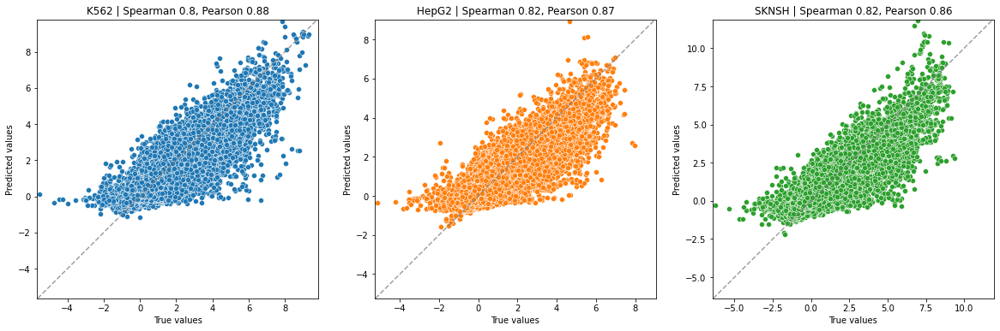

In [10]:
test_truths, test_preds = get_predictions(my_model, datamodule, dataset='chr_test')
get_scatterplots(test_truths, test_preds)


In [13]:
cv_01 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_2/model_artifacts__20230111_192235__715916.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_3/model_artifacts__20230111_190417__993143.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_4/model_artifacts__20230112_000934__941678.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_5/model_artifacts__20230112_003327__287605.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_6/model_artifacts__20230112_020038__431749.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_7/model_artifacts__20230112_182326__436818.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_8/model_artifacts__20230112_014853__150994.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_9/model_artifacts__20230111_232551__863644.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_10/model_artifacts__20230112_024037__325298.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_11/model_artifacts__20230112_003539__758935.tar.gz',
]

In [16]:
test_preds

array([[ 0.44433576,  0.670417  ,  0.59909725],
       [ 0.47530866,  0.69110566,  0.61157894],
       [ 3.9423509 ,  2.4418511 ,  3.7493093 ],
       ...,
       [ 0.63975173,  0.8184333 ,  0.43682206],
       [ 0.1243725 , -0.09198841,  0.21729025],
       [ 0.28182304,  0.36640015,  0.5315722 ]], dtype=float32)

Loaded model from 20230111_192235 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8778125951938287, 0.86841237501749, 0.8664011493865011], average: 0.87
Spearmans: [0.8013667715473882, 0.8166068646244267, 0.8183262776810375], average: 0.81
----------------------------------------------
Loaded model from 20230111_190417 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8769748437519097, 0.8709461408298644, 0.8645243757696843], average: 0.87
Spearmans: [0.8019696541018879, 0.8190748258770232, 0.8170096252110133], average: 0.81
----------------------------------------------
Loaded model from 20230112_000934 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.875361056855723, 0.8684814195411443, 0.8643996508511422], average: 0.87
Spearmans: [0.7987487879560206, 0.8177563978576595, 0.8177861786327373], average: 0.81
----------------------------------------------
Loaded model from 20230112_003327 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8763245751569277, 0.8692679568677633, 0.8644774464428738], average: 0.87
Spearmans: [0.8021465451519884, 0.8181023774061236, 0.8183088175635944], average: 0.81
----------------------------------------------
Loaded model from 20230112_020038 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8771791091373421, 0.867917588050464, 0.8658088414898746], average: 0.87
Spearmans: [0.8003143021333343, 0.8150906976613218, 0.8170711946315061], average: 0.81
----------------------------------------------
Loaded model from 20230112_182326 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8781333244205486, 0.8702669777915086, 0.8644892648110896], average: 0.87
Spearmans: [0.8011700455639925, 0.818180584891334, 0.8176852855592197], average: 0.81
----------------------------------------------
Loaded model from 20230112_014853 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8736333482202676, 0.8656891268818266, 0.8634943711208705], average: 0.87
Spearmans: [0.7950343816153906, 0.8104446539679679, 0.8128043865760578], average: 0.81
----------------------------------------------
Loaded model from 20230111_232551 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8721682176246209, 0.8619476877207579, 0.8583599923846006], average: 0.86
Spearmans: [0.7958879582600772, 0.8087726077201449, 0.8104709450304467], average: 0.81
----------------------------------------------
Loaded model from 20230112_024037 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8764930208260711, 0.8685793924459, 0.8641416988202799], average: 0.87
Spearmans: [0.8004197571737216, 0.8164563715758227, 0.8161416881266675], average: 0.81
----------------------------------------------
Loaded model from 20230112_003539 in eval mode


archive unpacked in ./



----------------------------------------------
Pearsons: [0.8763122134051367, 0.866943109371673, 0.8634559324413643], average: 0.87
Spearmans: [0.8007426930897179, 0.8149075790946446, 0.8172020318829138], average: 0.81
----------------------------------------------


TypeError: expected Tensor as element 0 in argument 0, but got numpy.ndarray

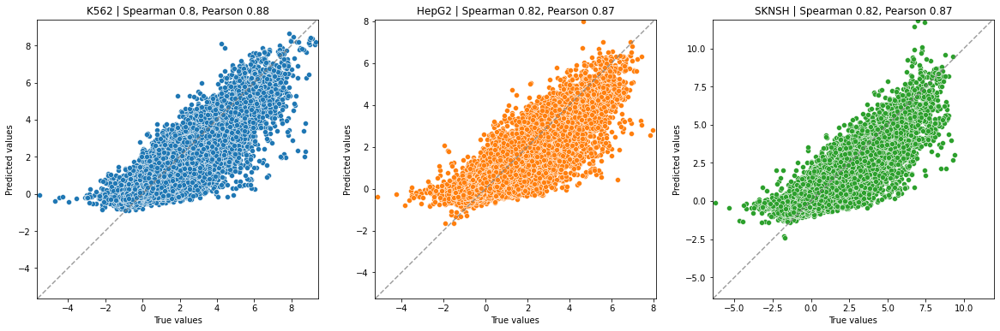

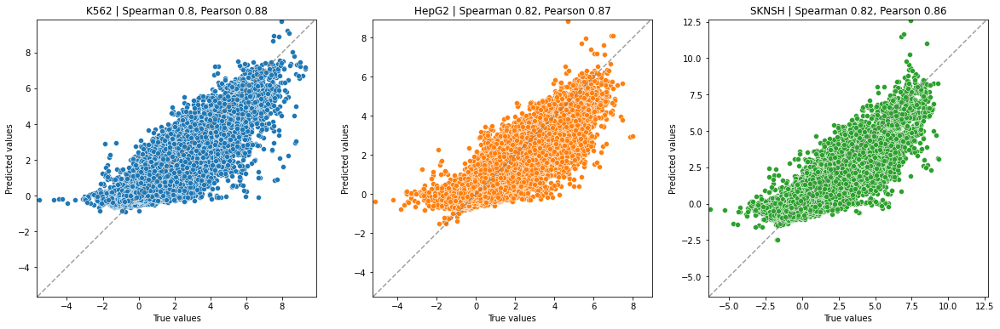

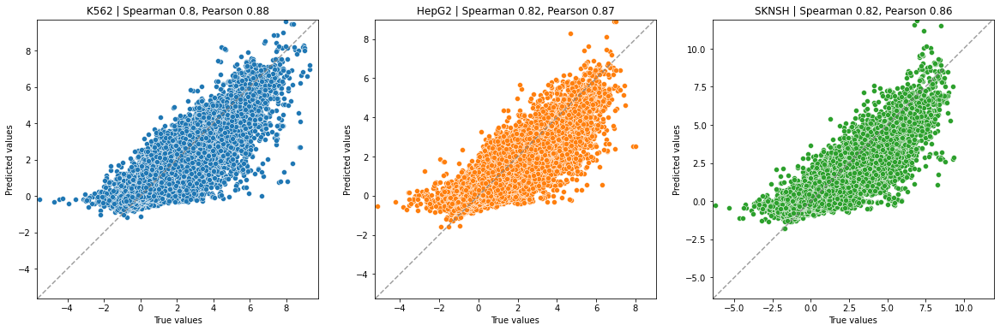

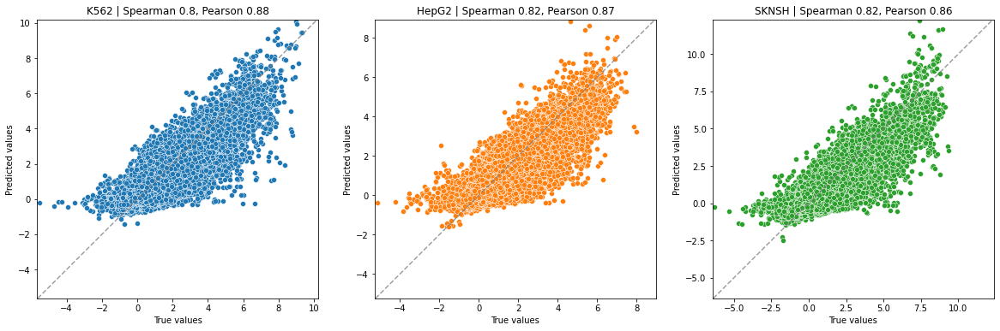

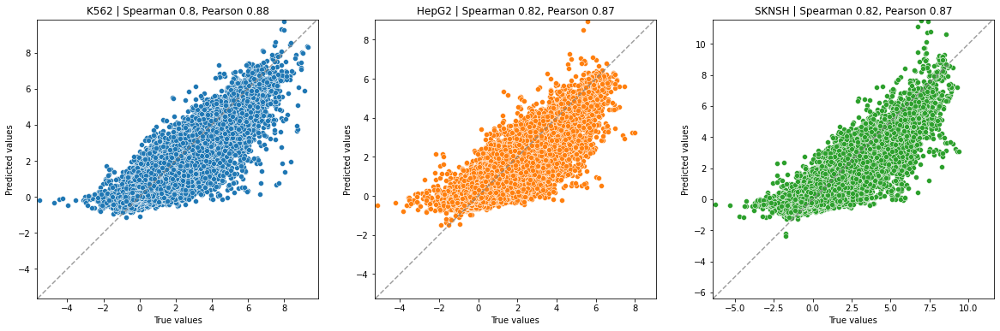

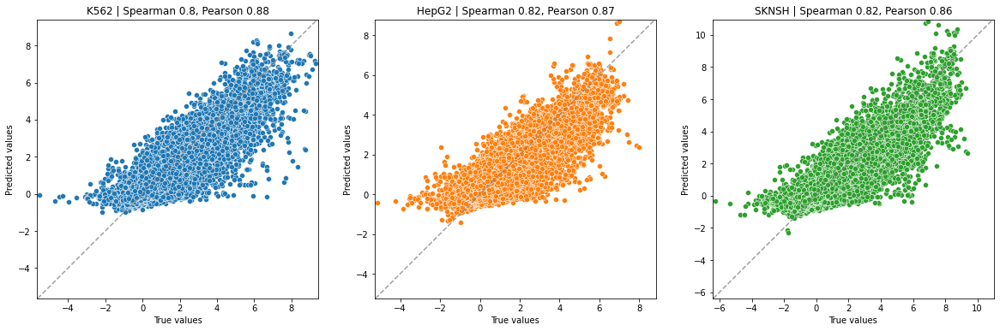

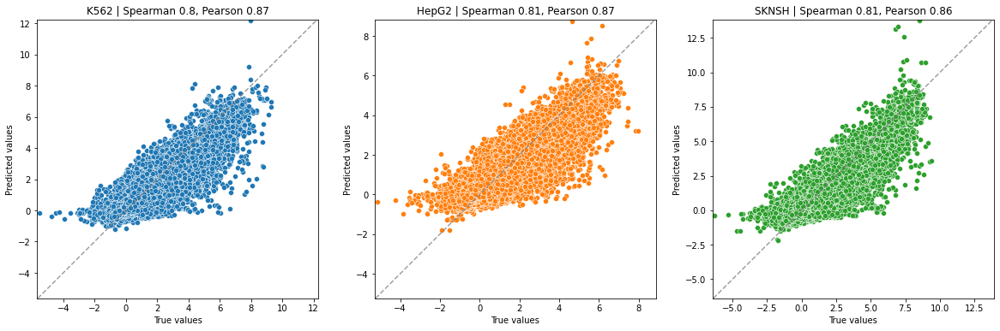

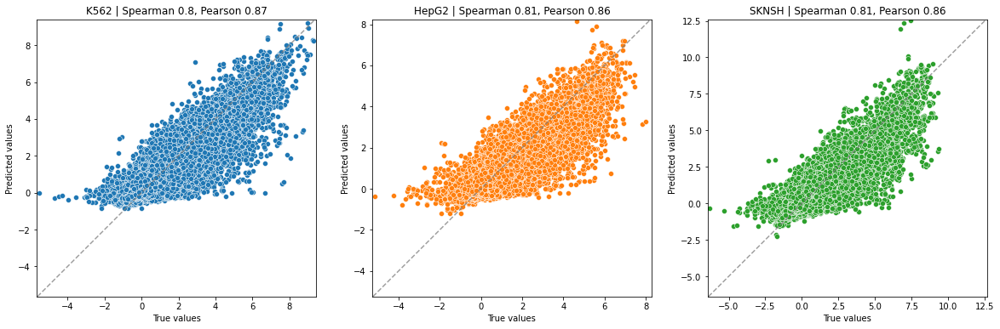

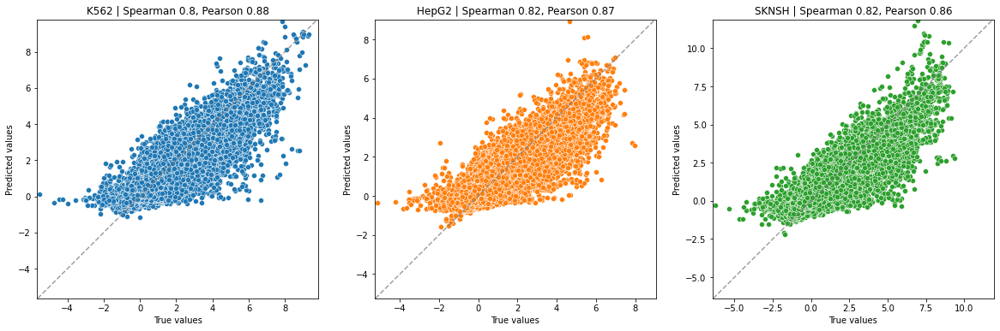

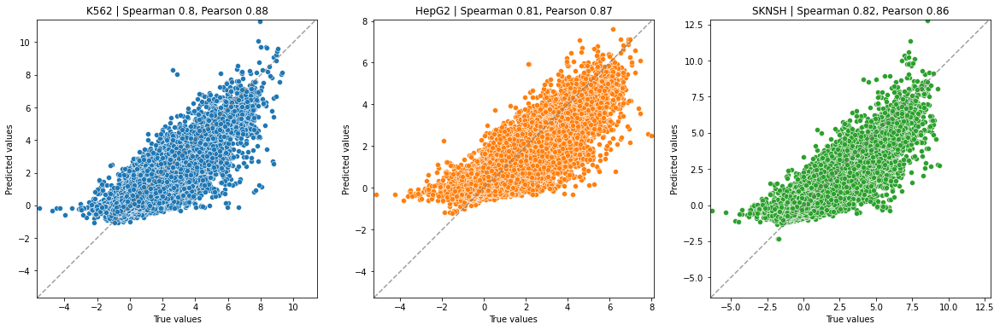

In [17]:
all_preds = []

for model_link in cv_01:
    if os.path.isdir('./artifacts'):
        shutil.rmtree('./artifacts')

    unpack_artifact(model_link)
    model_dir = './artifacts'
    my_model = model_fn(model_dir)

    my_model.cuda()
    my_model.eval()
    
    test_truths, test_preds = get_predictions(my_model, datamodule, dataset='chr_test')
    all_preds.append(test_preds)
    
    get_scatterplots(test_truths, test_preds)
    
all_preds = torch.stack(all_preds, dim=0).mean(dim=0)
get_scatterplots(test_truths, all_preds)


----------------------------------------------
Pearsons: [0.8998117778763045, 0.8929802558920853, 0.8866134284107622], average: 0.89
Spearmans: [0.8305155314509092, 0.8483028913894164, 0.8453638447066603], average: 0.84
----------------------------------------------


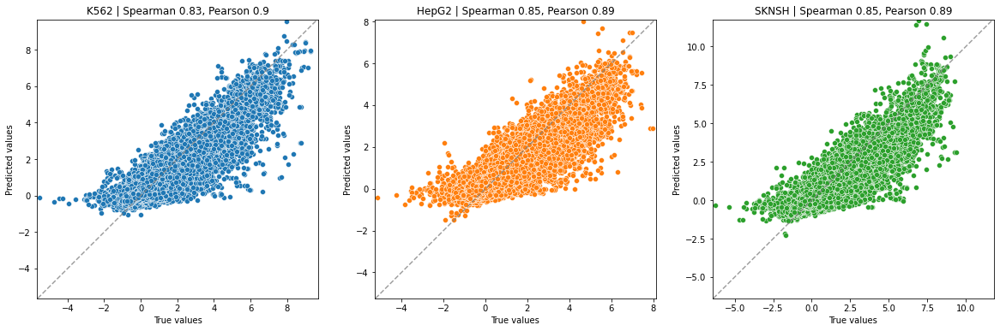

In [19]:
all_preds = np.stack(all_preds, axis=0).mean(axis=0)
get_scatterplots(test_truths, all_preds)

In [ ]:
data_file = 'gs://syrgoth/data/MPRA_ALL_v3.txt'

datamodule = boda.data.MPRA_DataModule(
    datafile_path=data_file,
    synth_seed=0,
    synth_val_pct=0.02,
    synth_test_pct=99.96,
    batch_size=2048,
    padded_seq_len=600, 
    num_workers=1,
    val_chrs=['X','Y'],
    test_chrs=['1','22'],
    data_project=['BODA','UKBB','GTEX']
)

datamodule.setup()

In [26]:
cv_01 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_2/model_artifacts__20230111_192235__715916.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_3/model_artifacts__20230111_190417__993143.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_4/model_artifacts__20230112_000934__941678.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_5/model_artifacts__20230112_003327__287605.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_6/model_artifacts__20230112_020038__431749.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_7/model_artifacts__20230112_182326__436818.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_8/model_artifacts__20230112_014853__150994.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_9/model_artifacts__20230111_232551__863644.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_10/model_artifacts__20230112_024037__325298.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_1_val_11/model_artifacts__20230112_003539__758935.tar.gz',
]
test_01 = ['1','22']

cv_02 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_1/model_artifacts__20230112_041842__826676.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_3/model_artifacts__20230112_173424__415672.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_4/model_artifacts__20230112_014533__217034.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_5/model_artifacts__20230112_003824__879872.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_6/model_artifacts__20230111_233731__117900.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_7/model_artifacts__20230112_023910__737605.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_8/model_artifacts__20230112_004119__145637.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_9/model_artifacts__20230112_005430__748782.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_10/model_artifacts__20230112_031741__363749.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_2_val_11/model_artifacts__20230112_002409__248129.tar.gz',
]
test_02 = ['2','21']

cv_03 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_1/model_artifacts__20230112_023929__405606.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_2/model_artifacts__20230112_015916__701525.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_4/model_artifacts__20230111_231119__118523.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_5/model_artifacts__20230112_030210__392582.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_6/model_artifacts__20230112_030423__258279.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_7/model_artifacts__20230112_042933__832450.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_8/model_artifacts__20230112_031424__606064.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_9/model_artifacts__20230111_233905__427951.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_10/model_artifacts__20230112_003310__726801.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_3_val_11/model_artifacts__20230112_011318__784858.tar.gz',
]
test_03 = ['3','20']

cv_04 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_1/model_artifacts__20230112_022358__442606.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_2/model_artifacts__20230112_005647__982883.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_3/model_artifacts__20230112_011252__557951.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_5/model_artifacts__20230112_021008__371487.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_6/model_artifacts__20230112_012839__343552.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_7/model_artifacts__20230112_014000__223633.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_8/model_artifacts__20230112_033649__433315.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_9/model_artifacts__20230112_015830__811736.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_10/model_artifacts__20230112_023014__868441.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_4_val_11/model_artifacts__20230112_012419__846505.tar.gz',
]
test_04 = ['4','19']

cv_05 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_1/model_artifacts__20230111_235836__604174.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_2/model_artifacts__20230112_033119__914315.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_3/model_artifacts__20230112_023021__269702.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_4/model_artifacts__20230112_002558__263046.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_6/model_artifacts__20230112_044219__995623.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_7/model_artifacts__20230112_014434__525150.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_8/model_artifacts__20230112_004545__982498.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_9/model_artifacts__20230112_032301__307278.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_10/model_artifacts__20230112_003033__415256.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_5_val_11/model_artifacts__20230111_233924__132454.tar.gz',
]
test_05 = ['5','18']

cv_06 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_1/model_artifacts__20230112_033521__524593.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_2/model_artifacts__20230112_043920__870508.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_3/model_artifacts__20230112_040520__506180.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_4/model_artifacts__20230112_023213__911133.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_5/model_artifacts__20230112_003816__931154.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_7/model_artifacts__20230112_005837__838473.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_8/model_artifacts__20230112_030053__300343.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_9/model_artifacts__20230112_005344__197182.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_10/model_artifacts__20230112_010900__765813.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_6_val_11/model_artifacts__20230112_040504__132558.tar.gz',
]
test_06 = ['6','17']

cv_07 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_1/model_artifacts__20230112_005920__369226.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_2/model_artifacts__20230112_042513__545458.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_3/model_artifacts__20230111_234041__233096.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_4/model_artifacts__20230112_015315__170342.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_5/model_artifacts__20230112_023015__950528.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_6/model_artifacts__20230112_032324__192945.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_8/model_artifacts__20230112_050443__633662.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_9/model_artifacts__20230112_023239__627813.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_10/model_artifacts__20230112_033504__678937.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_7_val_11/model_artifacts__20230112_011949__620636.tar.gz',
]
test_07 = ['7','16']

cv_08 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_1/model_artifacts__20230112_033415__555153.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_2/model_artifacts__20230111_235235__239767.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_3/model_artifacts__20230112_032522__994866.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_4/model_artifacts__20230112_010218__786570.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_5/model_artifacts__20230112_011225__624161.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_6/model_artifacts__20230112_034146__220003.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_7/model_artifacts__20230112_032715__402958.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_9/model_artifacts__20230112_035958__844529.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_10/model_artifacts__20230111_231916__547307.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_8_val_11/model_artifacts__20230112_082925__883327.tar.gz',
]
test_08 = ['8','15']

cv_09 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_1/model_artifacts__20230112_011852__672429.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_2/model_artifacts__20230112_012316__421576.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_3/model_artifacts__20230112_030608__546744.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_4/model_artifacts__20230112_004715__989057.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_5/model_artifacts__20230112_004934__133559.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_6/model_artifacts__20230112_045850__411630.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_7/model_artifacts__20230112_053708__678212.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_8/model_artifacts__20230112_051056__680970.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_10/model_artifacts__20230112_010359__394899.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_9_val_11/model_artifacts__20230112_023617__549629.tar.gz',
]
test_09 = ['9','14']

cv_10 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_1/model_artifacts__20230112_024434__335913.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_2/model_artifacts__20230112_023138__998417.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_3/model_artifacts__20230111_235821__277233.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_4/model_artifacts__20230112_035135__123814.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_5/model_artifacts__20230111_233239__997250.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_6/model_artifacts__20230112_020147__347055.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_7/model_artifacts__20230112_012222__381748.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_8/model_artifacts__20230112_012717__535279.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_9/model_artifacts__20230111_234320__438979.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_10_val_11/model_artifacts__20230112_023108__931734.tar.gz',
]
test_10 = ['10','13']

cv_11 = [
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_1/model_artifacts__20230111_235303__659225.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_2/model_artifacts__20230112_023851__149481.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_3/model_artifacts__20230112_005738__896100.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_4/model_artifacts__20230112_040839__627462.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_5/model_artifacts__20230112_001449__939787.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_6/model_artifacts__20230111_233248__277586.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_7/model_artifacts__20230111_235956__930333.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_8/model_artifacts__20230111_234647__930924.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_9/model_artifacts__20230112_002507__882336.tar.gz',
    'gs://tewhey-public-data/crossval_models/models_230111/test_11_val_10/model_artifacts__20230112_010807__554895.tar.gz',
]
test_11 = ['11','12']



In [27]:
cv_list = [cv_01, cv_02, cv_03, cv_04, cv_05, cv_06, cv_07, cv_08, cv_09, cv_10, cv_11]
test_list=[test_01, test_02, test_03, test_04, test_05, test_06, test_07, test_08, test_09, test_10, test_11]

  0%|          | 0/11 [00:00<?, ?it/s]

--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 675915 (85.27%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  107572 (13.57%)

Excluded from train: 0 (0.0)%
--------------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230111_192235 in eval mode


archive unpacked in ./


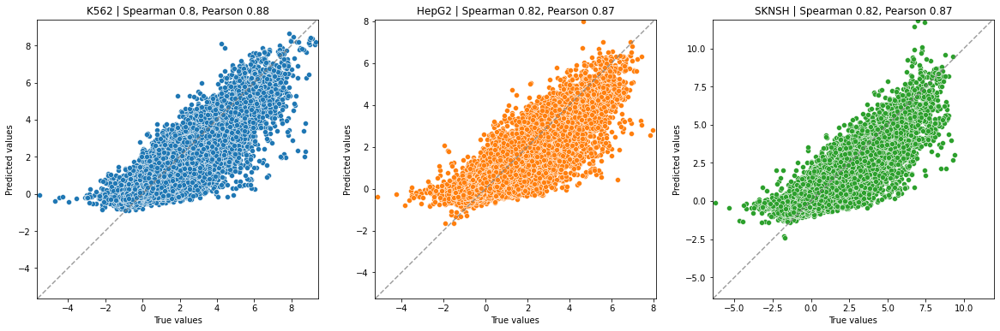


----------------------------------------------
Pearsons: [0.8778125951938287, 0.86841237501749, 0.8664011493865011], average: 0.87
Spearmans: [0.8013667715473882, 0.8166068646244267, 0.8183262776810375], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230111_190417 in eval mode


archive unpacked in ./


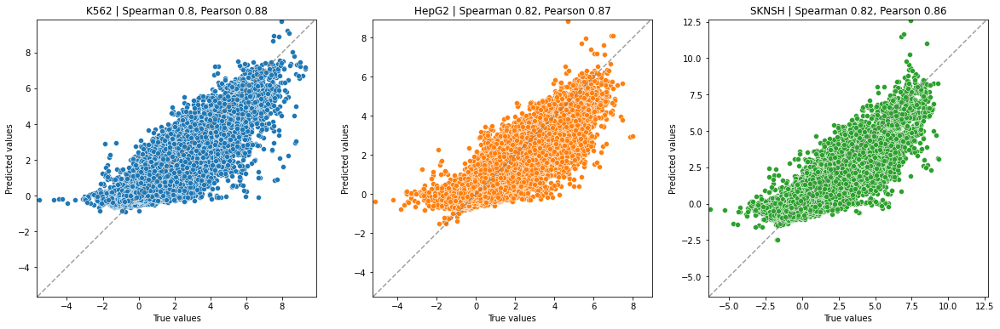


----------------------------------------------
Pearsons: [0.8769748437519097, 0.8709461408298644, 0.8645243757696843], average: 0.87
Spearmans: [0.8019696541018879, 0.8190748258770232, 0.8170096252110133], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230112_000934 in eval mode


archive unpacked in ./


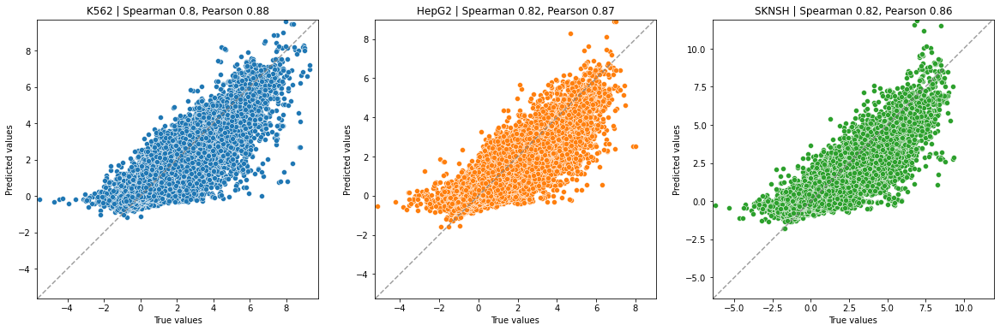


----------------------------------------------
Pearsons: [0.875361056855723, 0.8684814195411443, 0.8643996508511422], average: 0.87
Spearmans: [0.7987487879560206, 0.8177563978576595, 0.8177861786327373], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230112_003327 in eval mode


archive unpacked in ./


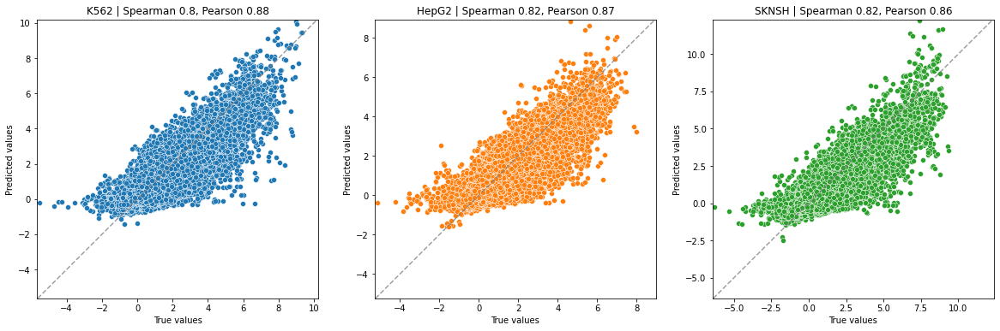


----------------------------------------------
Pearsons: [0.8763245751569277, 0.8692679568677633, 0.8644774464428738], average: 0.87
Spearmans: [0.8021465451519884, 0.8181023774061236, 0.8183088175635944], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230112_020038 in eval mode


archive unpacked in ./


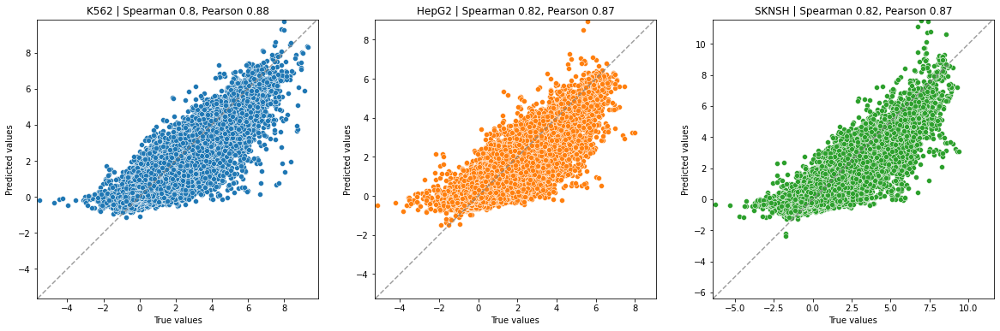


----------------------------------------------
Pearsons: [0.8771791091373421, 0.867917588050464, 0.8658088414898746], average: 0.87
Spearmans: [0.8003143021333343, 0.8150906976613218, 0.8170711946315061], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230112_182326 in eval mode


archive unpacked in ./


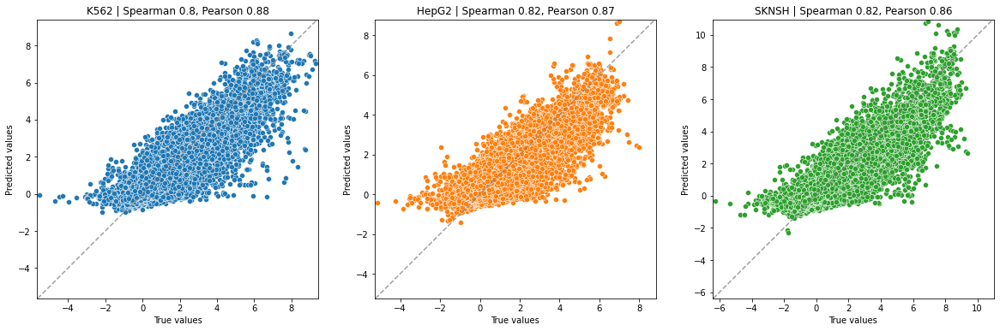


----------------------------------------------
Pearsons: [0.8781333244205486, 0.8702669777915086, 0.8644892648110896], average: 0.87
Spearmans: [0.8011700455639925, 0.818180584891334, 0.8176852855592197], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230112_014853 in eval mode


archive unpacked in ./


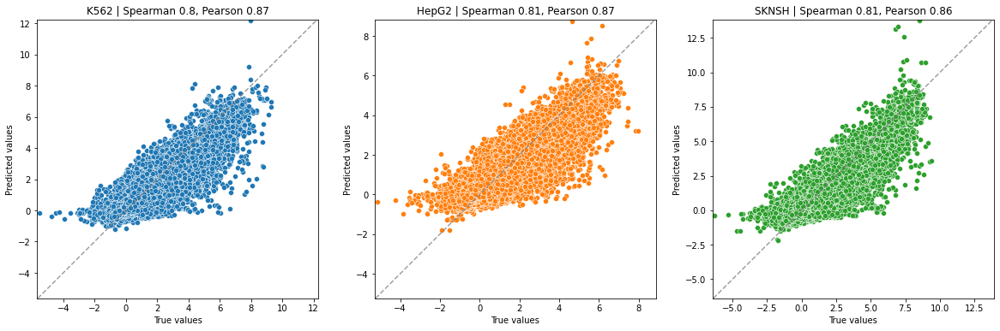


----------------------------------------------
Pearsons: [0.8736333482202676, 0.8656891268818266, 0.8634943711208705], average: 0.87
Spearmans: [0.7950343816153906, 0.8104446539679679, 0.8128043865760578], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230111_232551 in eval mode


archive unpacked in ./


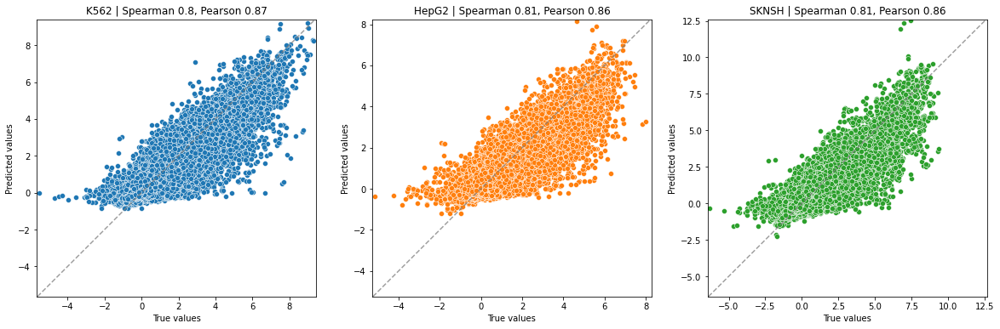


----------------------------------------------
Pearsons: [0.8721682176246209, 0.8619476877207579, 0.8583599923846006], average: 0.86
Spearmans: [0.7958879582600772, 0.8087726077201449, 0.8104709450304467], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230112_024037 in eval mode


archive unpacked in ./


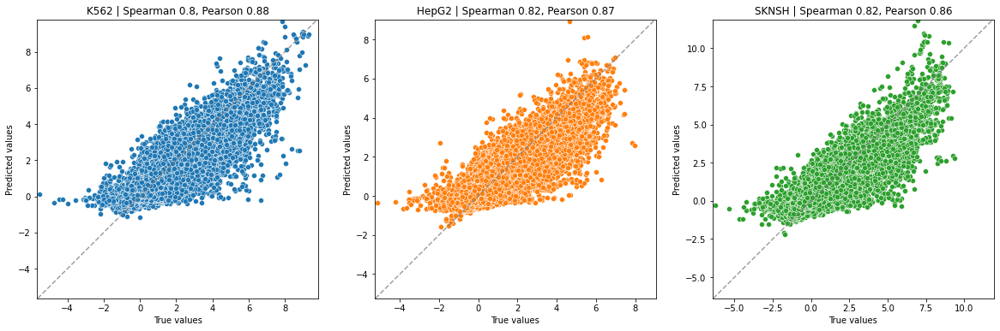


----------------------------------------------
Pearsons: [0.8764930208260711, 0.8685793924459, 0.8641416988202799], average: 0.87
Spearmans: [0.8004197571737216, 0.8164563715758227, 0.8161416881266675], average: 0.81
----------------------------------------------
on chromosome 1
reporting per model results
Loaded model from 20230112_003539 in eval mode


archive unpacked in ./


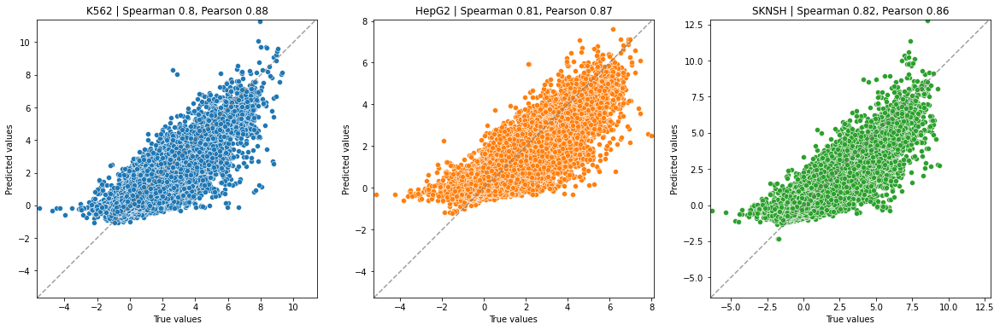


----------------------------------------------
Pearsons: [0.8763122134051367, 0.866943109371673, 0.8634559324413643], average: 0.87
Spearmans: [0.8007426930897179, 0.8149075790946446, 0.8172020318829138], average: 0.81
----------------------------------------------
Aggregate results for chromosome 1


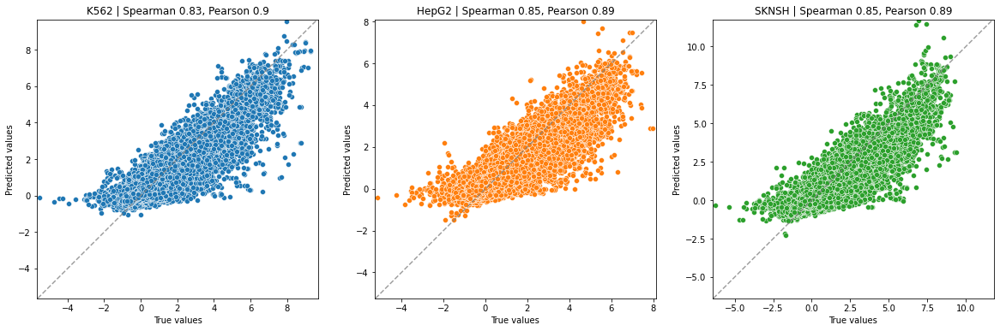

  9%|▉         | 1/11 [05:37<56:16, 337.64s/it]


----------------------------------------------
Pearsons: [0.8998117778763045, 0.8929802558920853, 0.8866134284107622], average: 0.89
Spearmans: [0.8305155314509092, 0.8483028913894164, 0.8453638447066603], average: 0.84
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 698015 (88.06%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  85472 (10.78%)

Excluded from train: 0 (0.0)%
-------------------------------------------

archive unpacked in ./


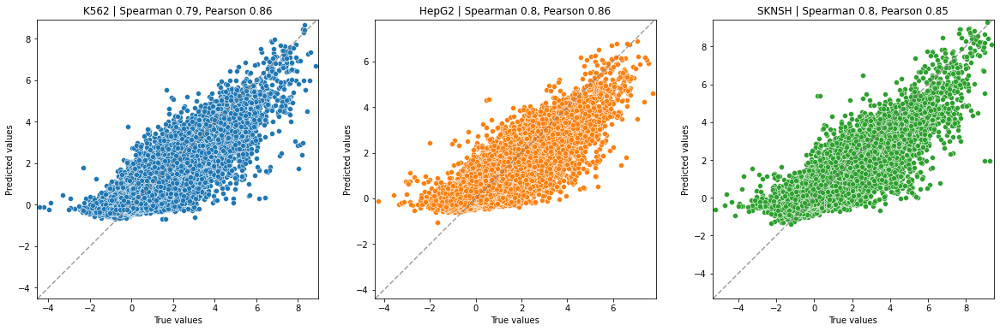


----------------------------------------------
Pearsons: [0.8637718185350075, 0.8575576039965855, 0.8523074008678166], average: 0.86
Spearmans: [0.7865017693206847, 0.8002923785083522, 0.7979935224665721], average: 0.79
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_173424 in eval mode


archive unpacked in ./


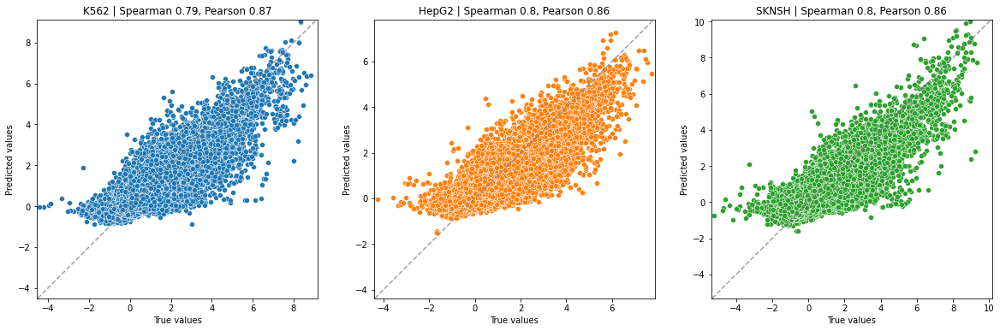


----------------------------------------------
Pearsons: [0.8674181798576562, 0.8589829639289152, 0.8558075530118712], average: 0.86
Spearmans: [0.7918790297403536, 0.8034056366614427, 0.8027354545023989], average: 0.8
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_014533 in eval mode


archive unpacked in ./


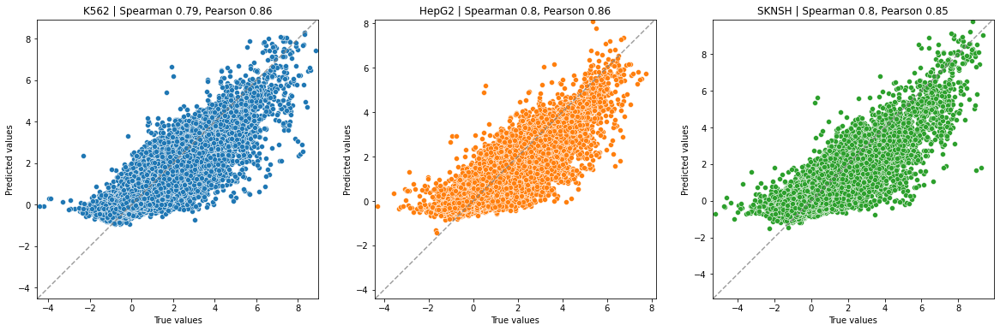


----------------------------------------------
Pearsons: [0.8632786077382351, 0.8590579062170008, 0.8530231495684858], average: 0.86
Spearmans: [0.78820181897646, 0.8047425641553211, 0.8012673122939232], average: 0.8
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_003824 in eval mode


archive unpacked in ./


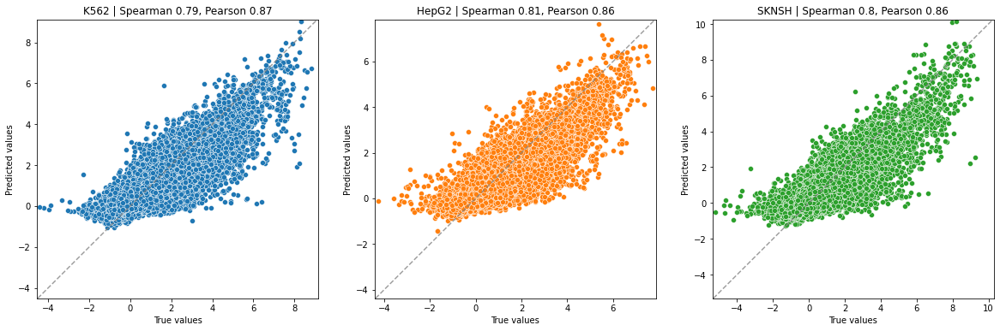


----------------------------------------------
Pearsons: [0.8662824691026632, 0.8614576176763793, 0.8569559716859125], average: 0.86
Spearmans: [0.7889098656444492, 0.8054660046618237, 0.8032841368815304], average: 0.8
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230111_233731 in eval mode


archive unpacked in ./


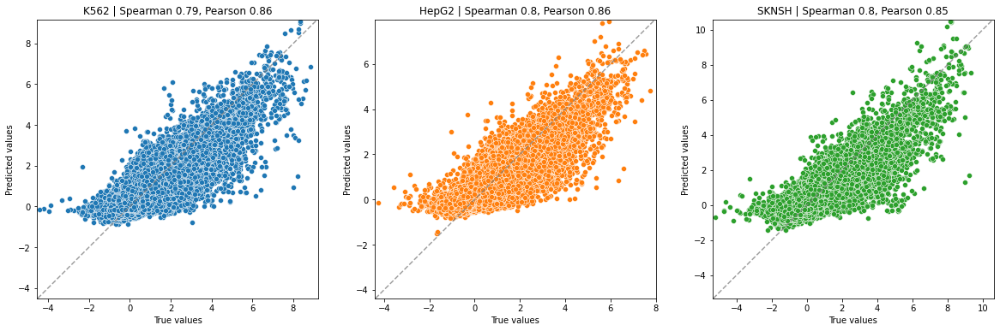


----------------------------------------------
Pearsons: [0.8612725362684995, 0.8567045548355001, 0.851349008982527], average: 0.86
Spearmans: [0.7851068650861059, 0.8004152483724537, 0.7982225837249521], average: 0.79
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_023910 in eval mode


archive unpacked in ./


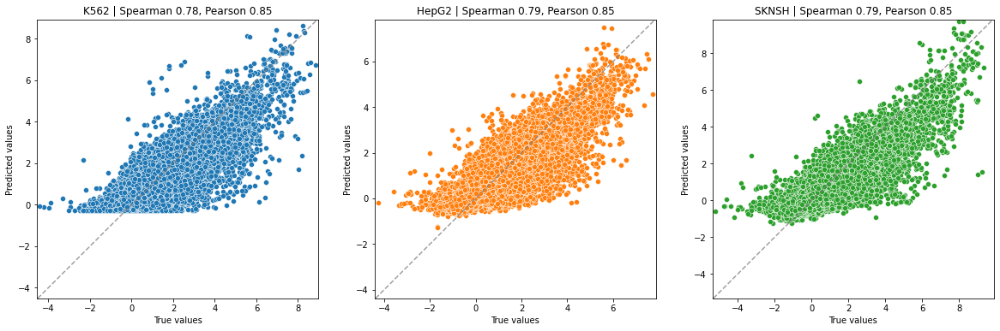


----------------------------------------------
Pearsons: [0.8521160645131097, 0.8488230787990185, 0.8451936459033184], average: 0.85
Spearmans: [0.7772388338944576, 0.793179951306583, 0.7901047271703121], average: 0.79
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_004119 in eval mode


archive unpacked in ./


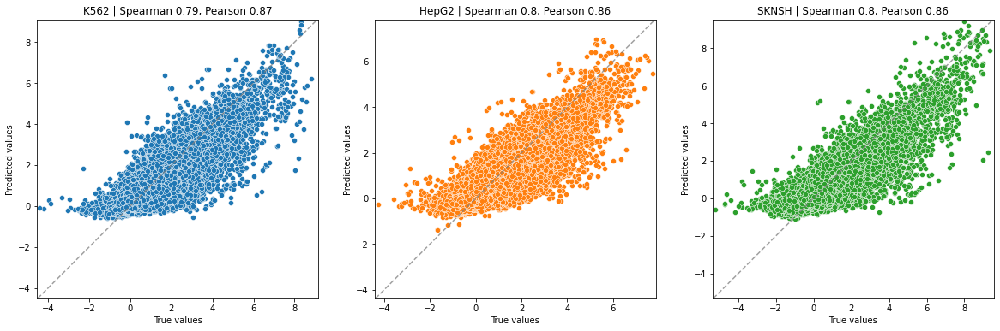


----------------------------------------------
Pearsons: [0.8665140996934255, 0.8622806233157263, 0.8574968132388695], average: 0.86
Spearmans: [0.7903868630416211, 0.8047626147859225, 0.8025295990180391], average: 0.8
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_005430 in eval mode


archive unpacked in ./


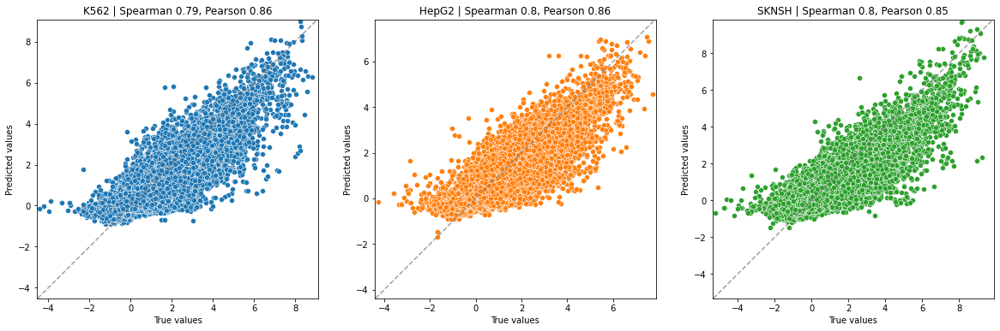


----------------------------------------------
Pearsons: [0.8643671706016344, 0.8585621848874215, 0.8537590103894506], average: 0.86
Spearmans: [0.7866647335350303, 0.8030278540179164, 0.7998530098234152], average: 0.8
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_031741 in eval mode


archive unpacked in ./


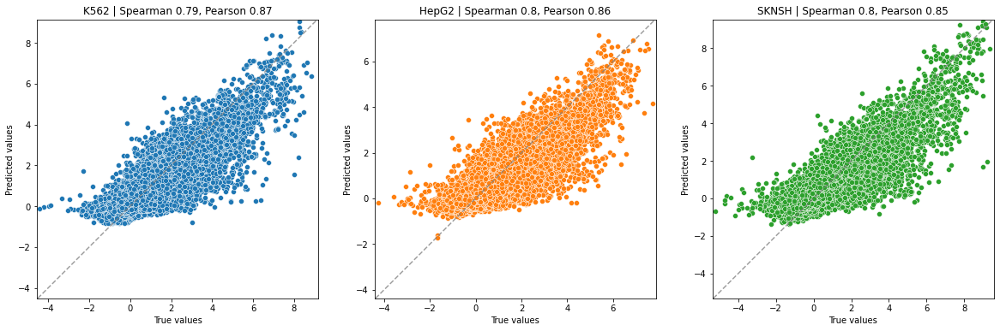


----------------------------------------------
Pearsons: [0.8653799377326995, 0.8582930513712306, 0.8538117568105176], average: 0.86
Spearmans: [0.7899975983675042, 0.803251711970697, 0.80180176861704], average: 0.8
----------------------------------------------
on chromosome 2
reporting per model results
Loaded model from 20230112_002409 in eval mode


archive unpacked in ./


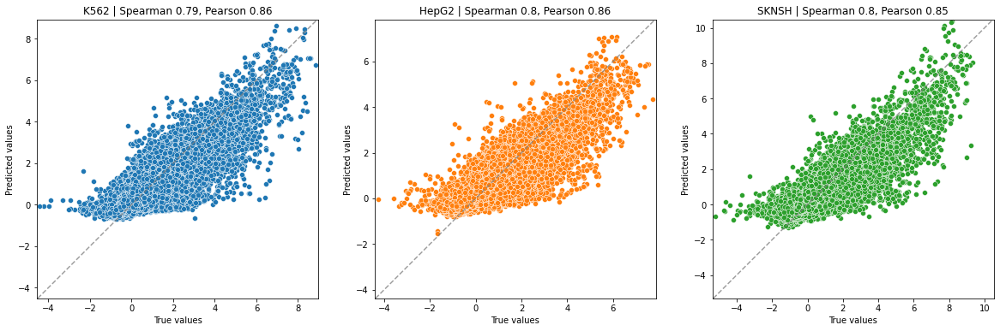


----------------------------------------------
Pearsons: [0.864946111470461, 0.8578408860826008, 0.8513665310520628], average: 0.86
Spearmans: [0.7896696352736027, 0.8034375580852593, 0.7994452500365131], average: 0.8
----------------------------------------------
Aggregate results for chromosome 2


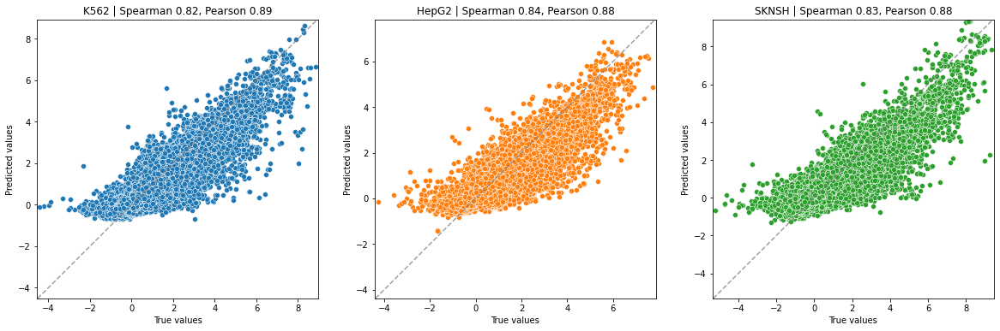

 18%|█▊        | 2/11 [11:17<50:51, 339.01s/it]


----------------------------------------------
Pearsons: [0.8893002952194723, 0.8848653905855597, 0.8774330465707456], average: 0.88
Spearmans: [0.8188429460561704, 0.8355707806540501, 0.829987396896192], average: 0.83
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 704304 (88.86%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  79183 (9.99%)

Excluded from train: 0 (0.0)%
---------------------------------------------

archive unpacked in ./


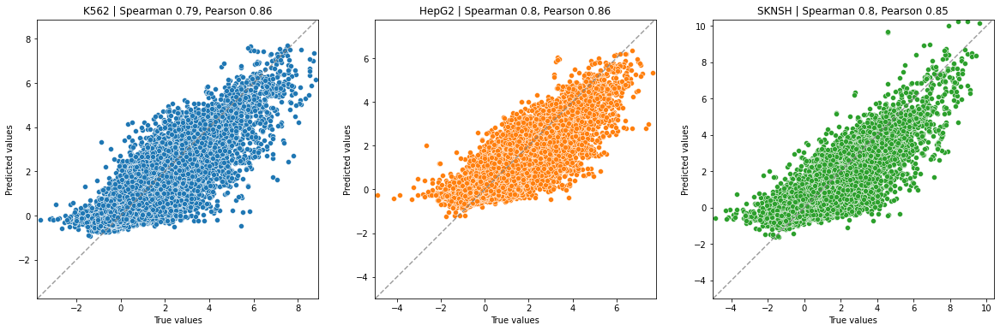


----------------------------------------------
Pearsons: [0.8630652603690875, 0.8573721448927567, 0.8505656861168349], average: 0.86
Spearmans: [0.7864647540980131, 0.7995594893688078, 0.7996497852054862], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230112_015916 in eval mode


archive unpacked in ./


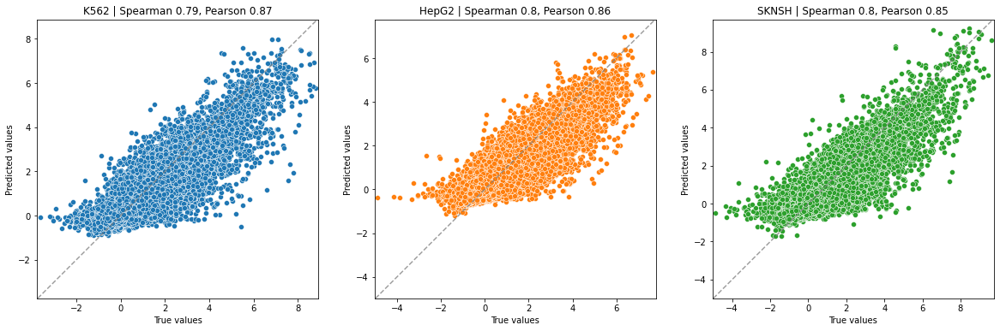


----------------------------------------------
Pearsons: [0.8684883678454719, 0.8624239144550878, 0.8538416089794816], average: 0.86
Spearmans: [0.790971070212195, 0.8037098286262804, 0.802082778279593], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230111_231119 in eval mode


archive unpacked in ./


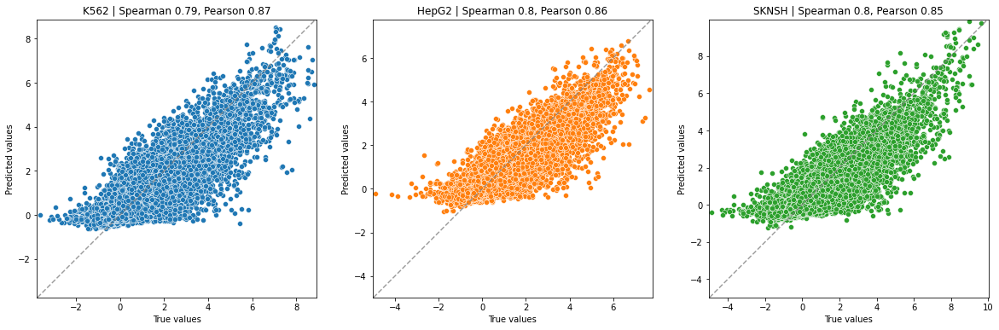


----------------------------------------------
Pearsons: [0.8653230355021143, 0.8600707795765994, 0.8517834739941176], average: 0.86
Spearmans: [0.7872274118891283, 0.8017787168938063, 0.8006501818342436], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230112_030210 in eval mode


archive unpacked in ./


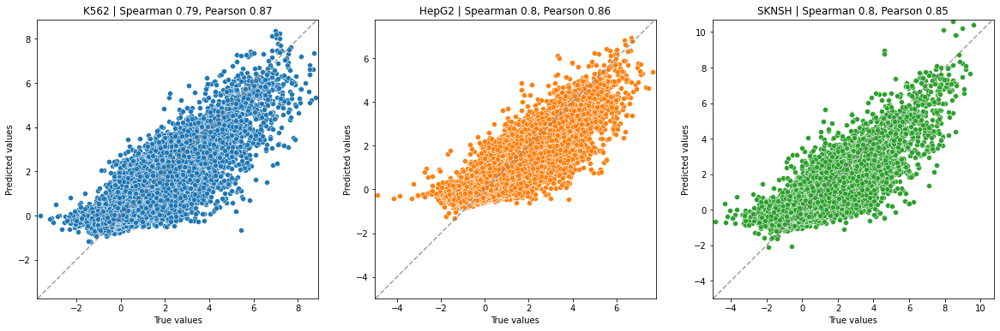


----------------------------------------------
Pearsons: [0.8652857382682397, 0.8607475534301492, 0.8495600723536694], average: 0.86
Spearmans: [0.7857000081362214, 0.8004532195857388, 0.7986502282634174], average: 0.79
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230112_030423 in eval mode


archive unpacked in ./


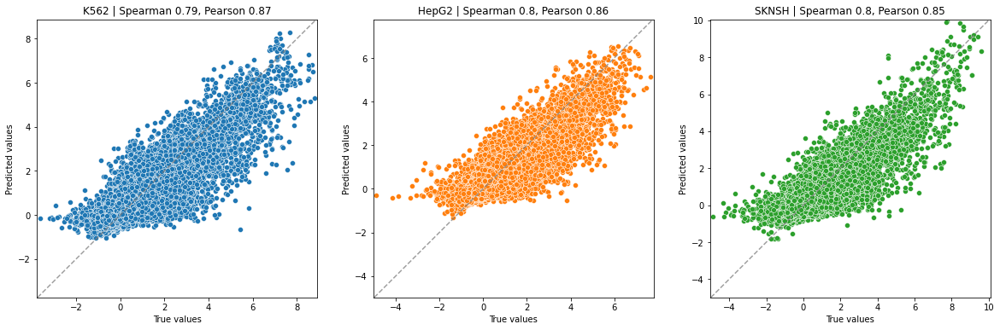


----------------------------------------------
Pearsons: [0.8657350885816238, 0.8623458262686607, 0.8542124192378144], average: 0.86
Spearmans: [0.7871206115461484, 0.8038231399565903, 0.8028311354486393], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230112_042933 in eval mode


archive unpacked in ./


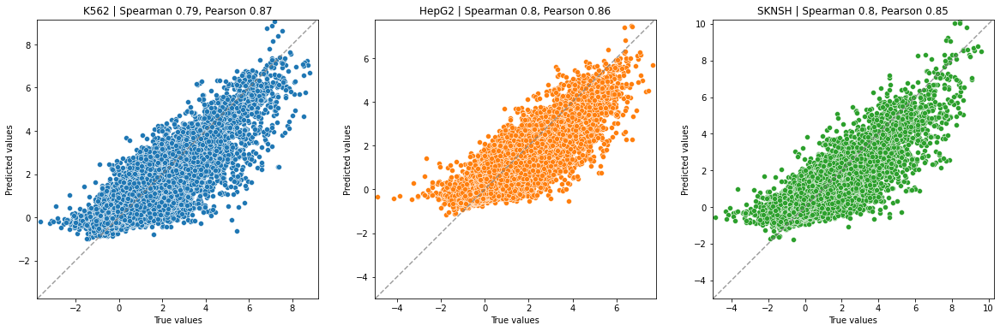


----------------------------------------------
Pearsons: [0.8663095843738564, 0.8635567754554139, 0.8533922297650336], average: 0.86
Spearmans: [0.7860499418631572, 0.8024480378031141, 0.8010722732951878], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230112_031424 in eval mode


archive unpacked in ./


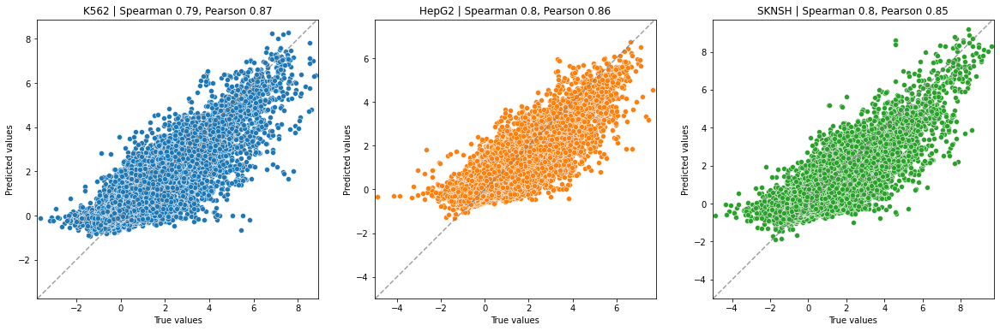


----------------------------------------------
Pearsons: [0.8660517474070397, 0.8594971537673004, 0.8514667936890074], average: 0.86
Spearmans: [0.7890961416382266, 0.8024434028392238, 0.8003899687168939], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230111_233905 in eval mode


archive unpacked in ./


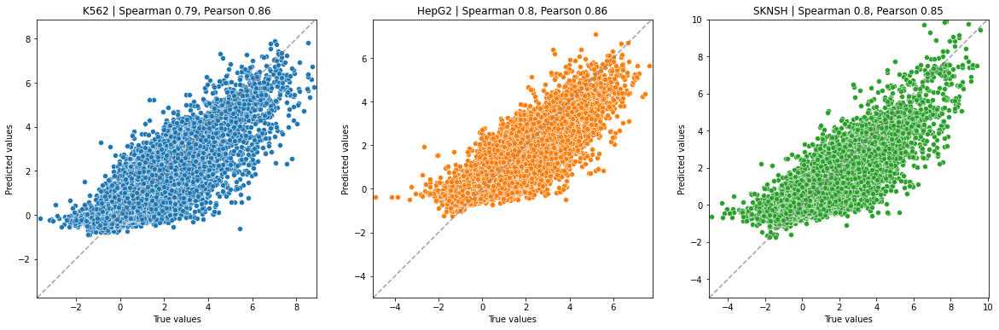


----------------------------------------------
Pearsons: [0.864776930629351, 0.859124067834971, 0.8503268069774709], average: 0.86
Spearmans: [0.7891930874943885, 0.8017662118731345, 0.8006508792817855], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230112_003310 in eval mode


archive unpacked in ./


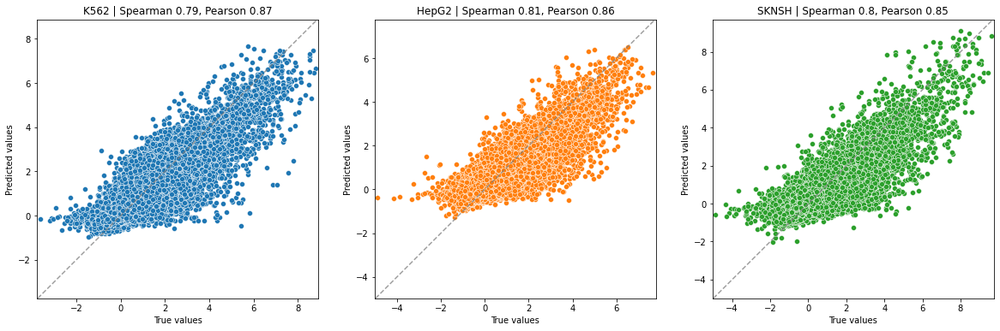


----------------------------------------------
Pearsons: [0.868967285201882, 0.8629277018213607, 0.851113107463208], average: 0.86
Spearmans: [0.7915238419816352, 0.8054526920505293, 0.8023531379715177], average: 0.8
----------------------------------------------
on chromosome 3
reporting per model results
Loaded model from 20230112_011318 in eval mode


archive unpacked in ./


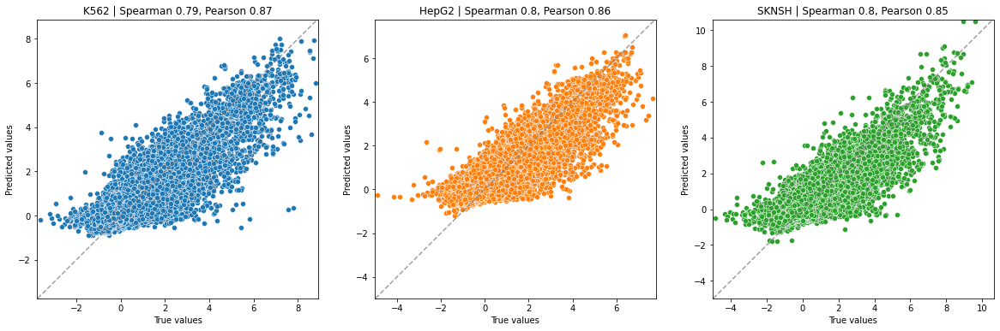


----------------------------------------------
Pearsons: [0.8660114180452609, 0.8602826172781243, 0.8542673579311542], average: 0.86
Spearmans: [0.7882681836279936, 0.8026936382586567, 0.8011256228236905], average: 0.8
----------------------------------------------
Aggregate results for chromosome 3


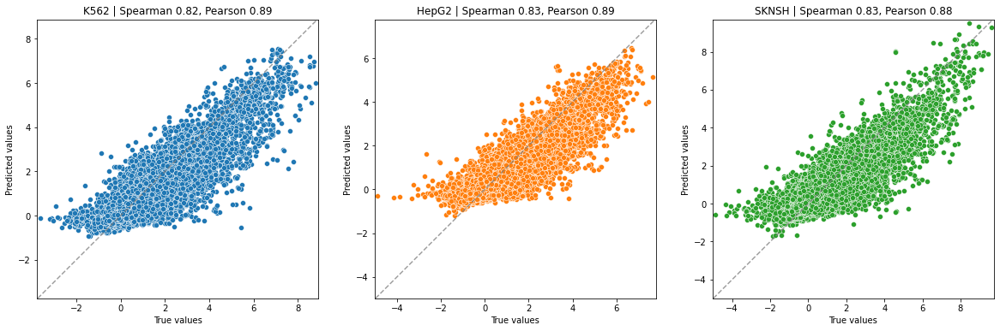

 27%|██▋       | 3/11 [16:56<45:12, 339.03s/it]


----------------------------------------------
Pearsons: [0.8907777155307783, 0.8866247035884838, 0.8756223267511644], average: 0.88
Spearmans: [0.8195577881275289, 0.8349283603392026, 0.8302386145350057], average: 0.83
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 691743 (87.27%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  91744 (11.57%)

Excluded from train: 0 (0.0)%
-------------------------------------------

archive unpacked in ./


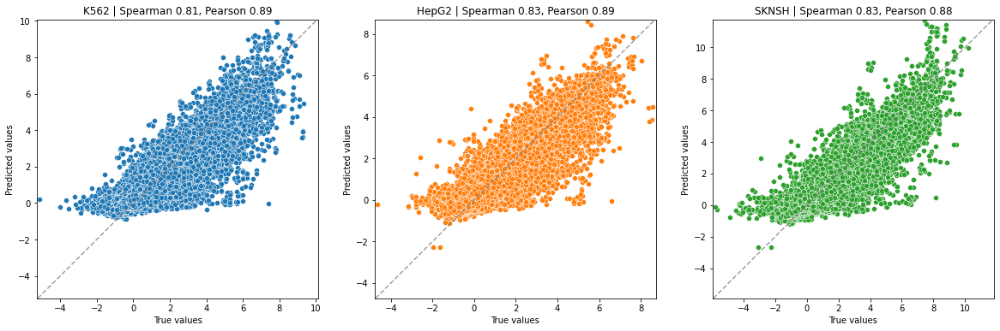


----------------------------------------------
Pearsons: [0.8916573645077521, 0.8886340973597171, 0.8797795672509449], average: 0.89
Spearmans: [0.8060500889011384, 0.8260412193518792, 0.8254323961057063], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_005647 in eval mode


archive unpacked in ./


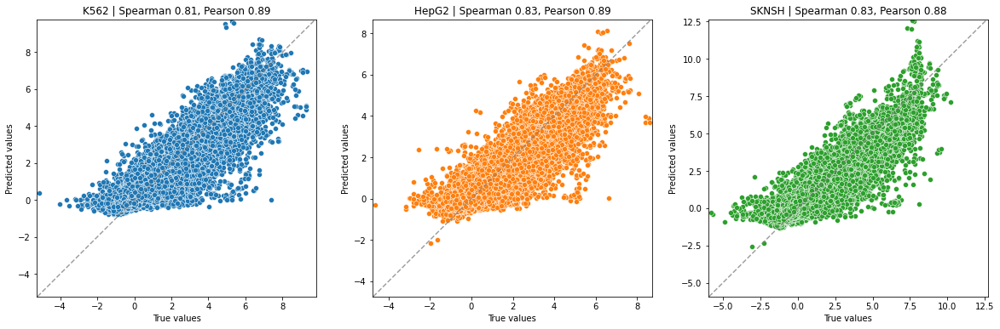


----------------------------------------------
Pearsons: [0.894309294754907, 0.8896666320943715, 0.8813964318080315], average: 0.89
Spearmans: [0.8071233654544787, 0.8277004317647152, 0.826832234466116], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_011252 in eval mode


archive unpacked in ./


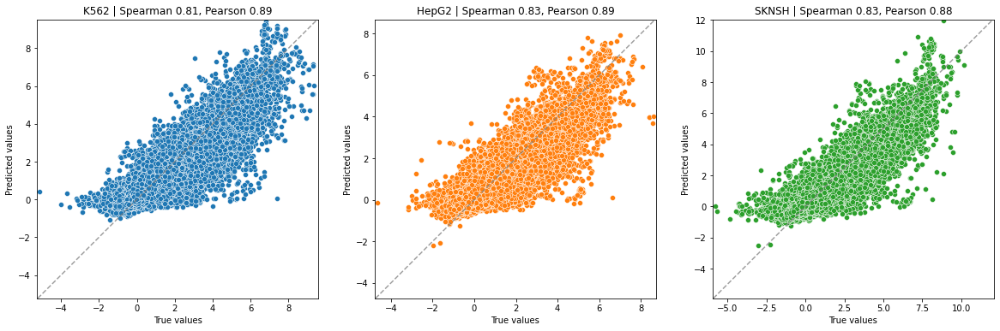


----------------------------------------------
Pearsons: [0.893474294485014, 0.8889279440296859, 0.8810095308280917], average: 0.89
Spearmans: [0.8056105638718253, 0.8278320481828185, 0.8268319685789053], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_021008 in eval mode


archive unpacked in ./


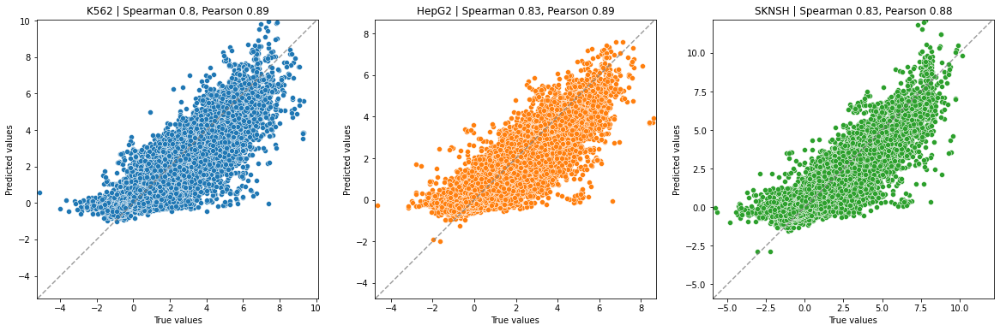


----------------------------------------------
Pearsons: [0.8913762626331789, 0.889890417193794, 0.8838183169379928], average: 0.89
Spearmans: [0.8049149438092541, 0.8294391065550937, 0.8280012095337516], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_012839 in eval mode


archive unpacked in ./


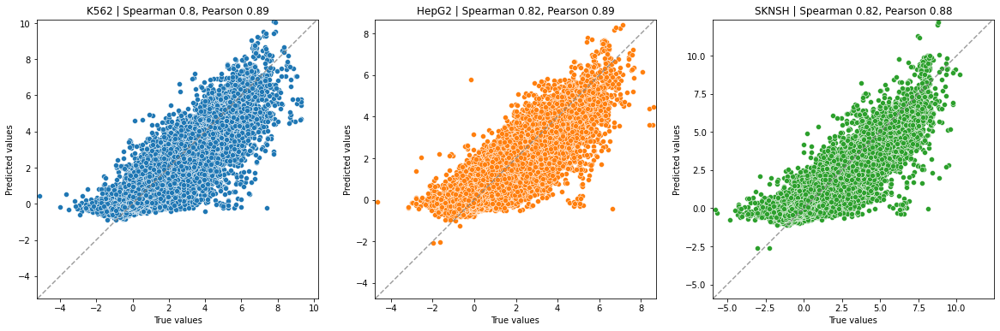


----------------------------------------------
Pearsons: [0.8896320224224139, 0.8870153271684225, 0.8803195435692974], average: 0.89
Spearmans: [0.8025102391826269, 0.8234328402781869, 0.8240598056092432], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_014000 in eval mode


archive unpacked in ./


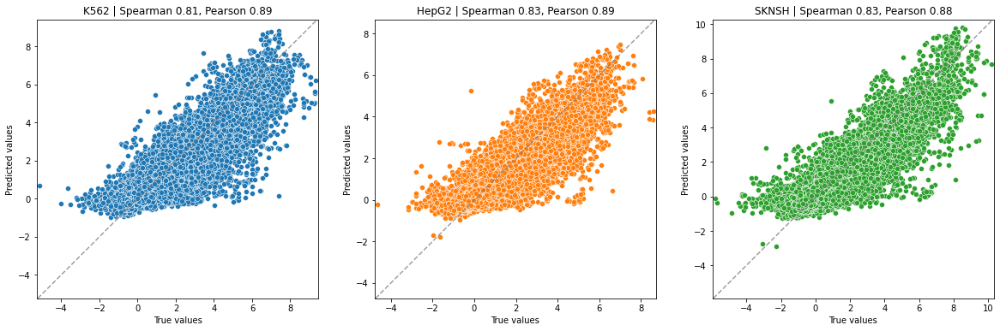


----------------------------------------------
Pearsons: [0.8914527727156683, 0.88878475412061, 0.8827392315290292], average: 0.89
Spearmans: [0.8067007000292415, 0.8271504733536946, 0.8261906585793045], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_033649 in eval mode


archive unpacked in ./


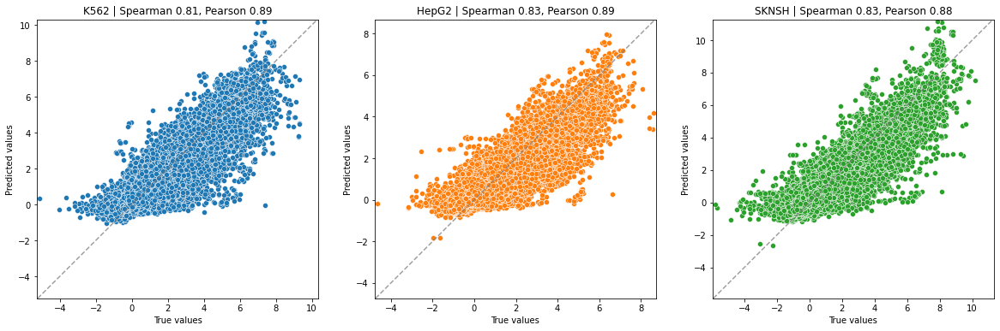


----------------------------------------------
Pearsons: [0.8932795375065614, 0.8887023591329911, 0.8827466094312264], average: 0.89
Spearmans: [0.8065352738105096, 0.8271587663442452, 0.8270004901693285], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_015830 in eval mode


archive unpacked in ./


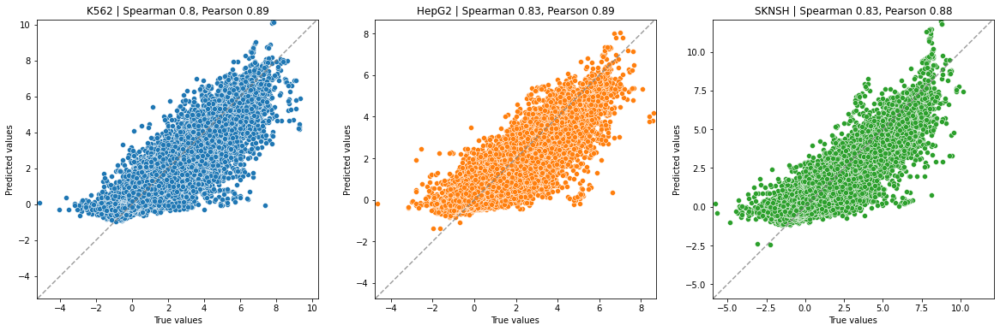


----------------------------------------------
Pearsons: [0.8919244473204471, 0.8896275209542827, 0.8812457161992457], average: 0.89
Spearmans: [0.804008559604331, 0.8262534559909698, 0.8252804982361617], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_023014 in eval mode


archive unpacked in ./


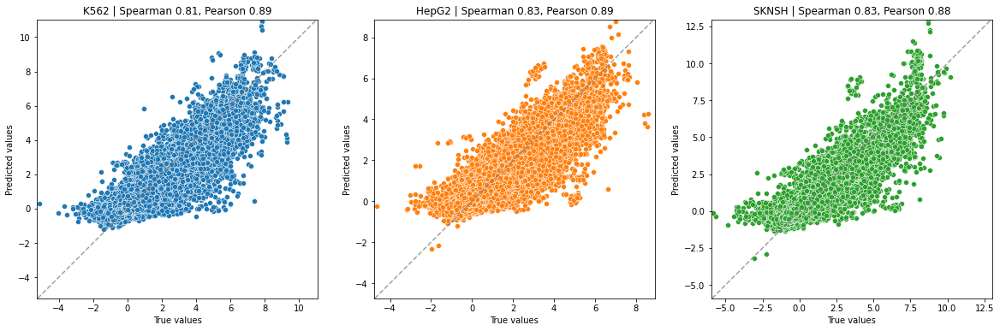


----------------------------------------------
Pearsons: [0.891809665456971, 0.8879993355472675, 0.8810122200132866], average: 0.89
Spearmans: [0.8066735686528583, 0.8275094845679017, 0.8277824005853363], average: 0.82
----------------------------------------------
on chromosome 4
reporting per model results
Loaded model from 20230112_012419 in eval mode


archive unpacked in ./


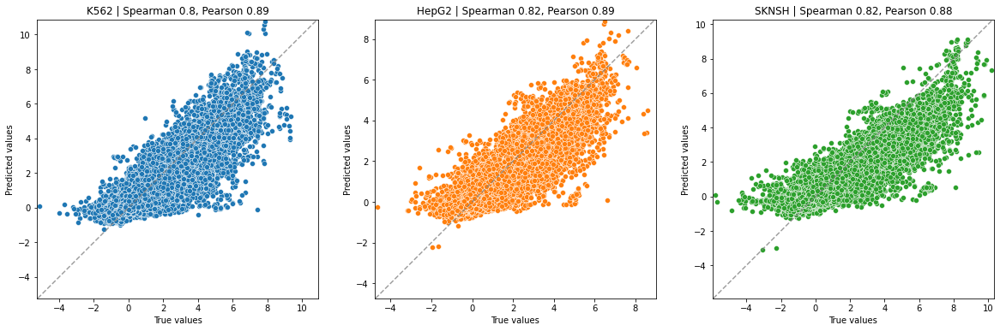


----------------------------------------------
Pearsons: [0.8901074832750451, 0.8876219286464316, 0.8800017698784139], average: 0.89
Spearmans: [0.8040598871425603, 0.824052660594408, 0.8238074801007287], average: 0.82
----------------------------------------------
Aggregate results for chromosome 4


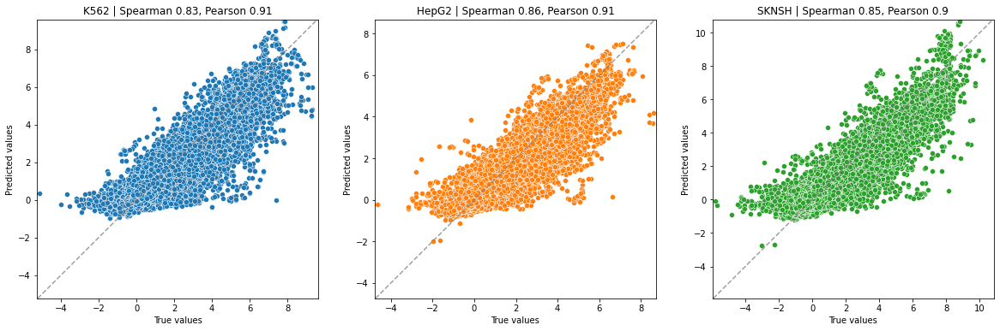

 36%|███▋      | 4/11 [22:38<39:39, 339.98s/it]


----------------------------------------------
Pearsons: [0.9096348449112706, 0.9080672641140904, 0.8994555573137912], average: 0.91
Spearmans: [0.8330007437338216, 0.8554594498854863, 0.8521282565727825], average: 0.85
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 714624 (90.16%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  68863 (8.69%)

Excluded from train: 0 (0.0)%
--------------------------------------------

archive unpacked in ./


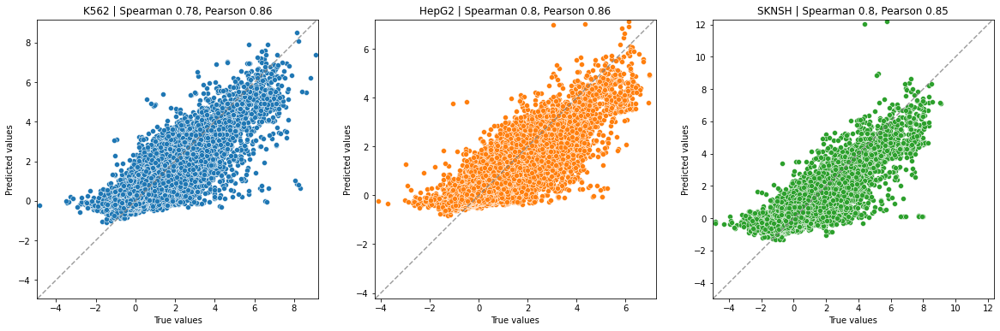


----------------------------------------------
Pearsons: [0.8587964462974226, 0.8552673500299866, 0.8472051779213301], average: 0.85
Spearmans: [0.7822827677189416, 0.8001071948270762, 0.7960684050651572], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_033119 in eval mode


archive unpacked in ./


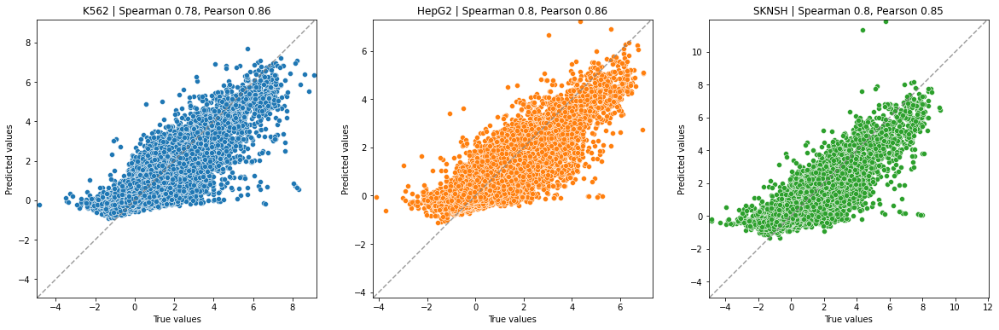


----------------------------------------------
Pearsons: [0.8610756273201754, 0.8615652753692667, 0.853556241987276], average: 0.86
Spearmans: [0.7812803974733792, 0.8008632384667512, 0.799671637794963], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_023021 in eval mode


archive unpacked in ./


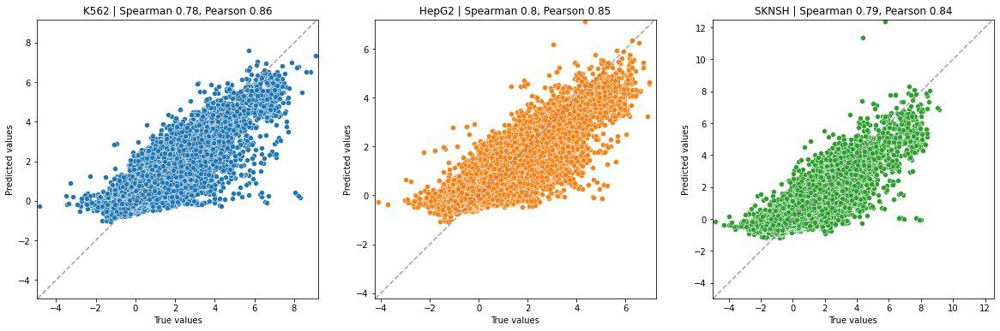


----------------------------------------------
Pearsons: [0.8590944483681209, 0.8530374510954655, 0.8440726207030261], average: 0.85
Spearmans: [0.7797154715466998, 0.7954919389546649, 0.7942656646181588], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_002558 in eval mode


archive unpacked in ./


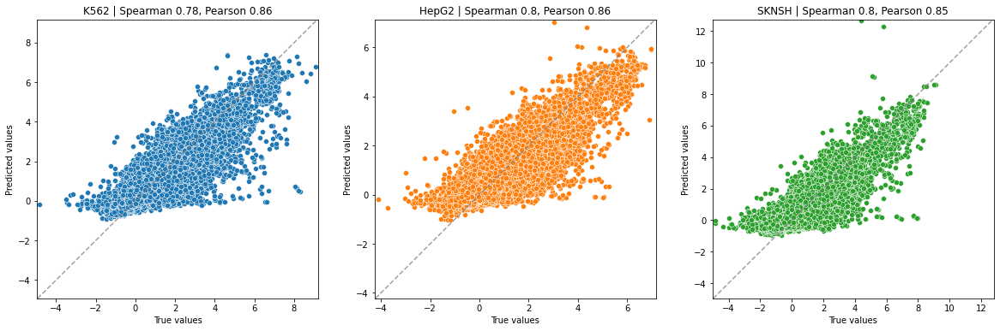


----------------------------------------------
Pearsons: [0.8600038214547461, 0.8612258499403158, 0.8533511025807304], average: 0.86
Spearmans: [0.7803978900262953, 0.8011921269882439, 0.8000863577787848], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_044219 in eval mode


archive unpacked in ./


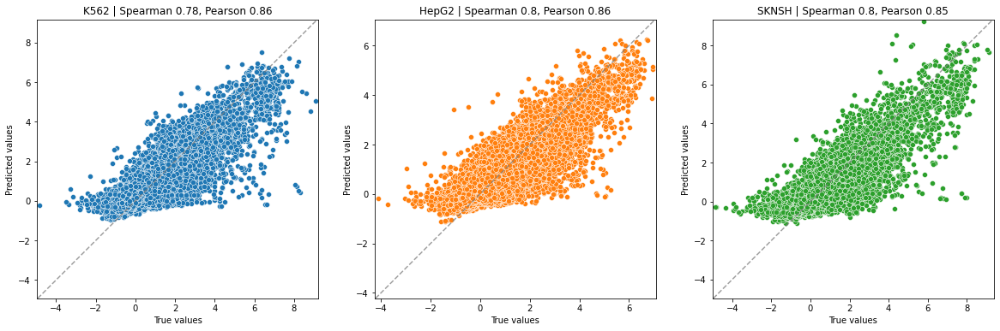


----------------------------------------------
Pearsons: [0.8586206019254012, 0.8597053245905351, 0.8519882345173649], average: 0.86
Spearmans: [0.7806349204389006, 0.8007764532299823, 0.8009162456932336], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_014434 in eval mode


archive unpacked in ./


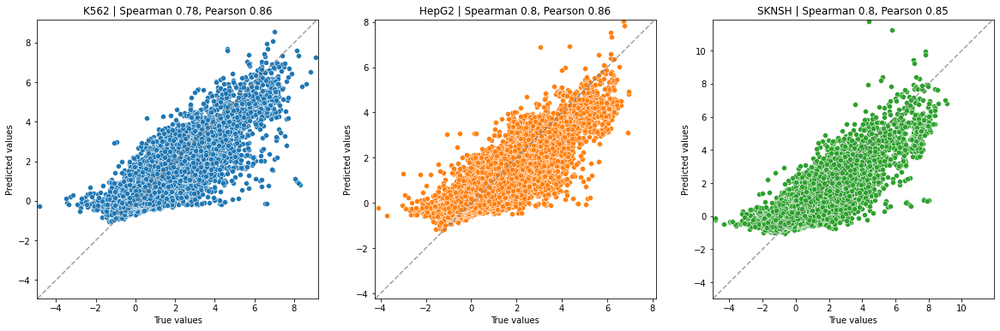


----------------------------------------------
Pearsons: [0.8597445611088946, 0.8571778158159898, 0.849902051563719], average: 0.86
Spearmans: [0.7792237546653918, 0.7979230982935784, 0.7989412612100447], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_004545 in eval mode


archive unpacked in ./


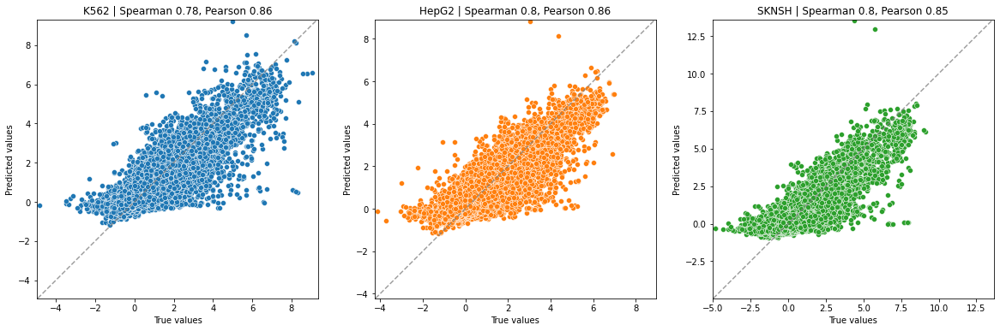


----------------------------------------------
Pearsons: [0.8586711237006672, 0.8598978886147178, 0.8516612169900899], average: 0.86
Spearmans: [0.7819386393456081, 0.8016498529323375, 0.8010740548241236], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_032301 in eval mode


archive unpacked in ./


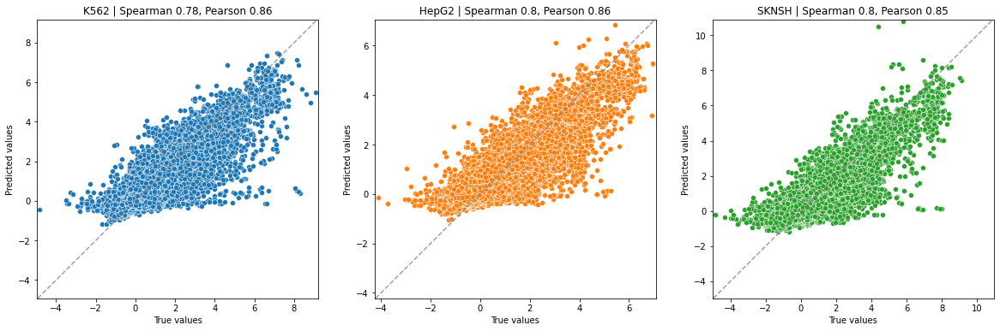


----------------------------------------------
Pearsons: [0.8574860992936097, 0.8581307665724799, 0.8521940940431936], average: 0.86
Spearmans: [0.7811617889767192, 0.7999684262680394, 0.7988500216344253], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230112_003033 in eval mode


archive unpacked in ./


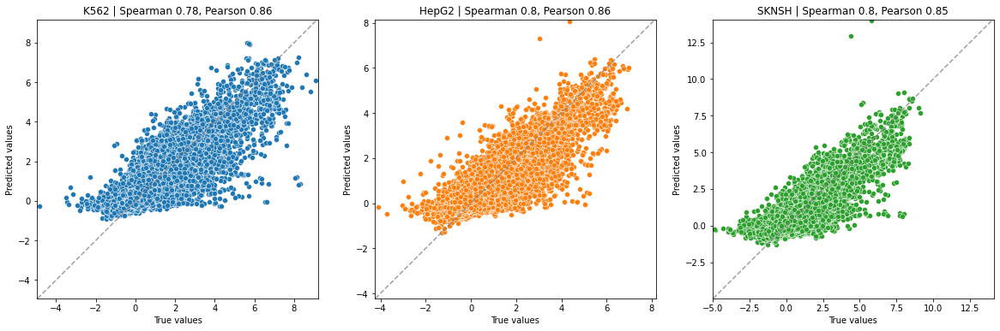


----------------------------------------------
Pearsons: [0.85536447196979, 0.8573137721281867, 0.8493120392659542], average: 0.85
Spearmans: [0.781642456054866, 0.7985712411510804, 0.7988492112475183], average: 0.79
----------------------------------------------
on chromosome 5
reporting per model results
Loaded model from 20230111_233924 in eval mode


archive unpacked in ./


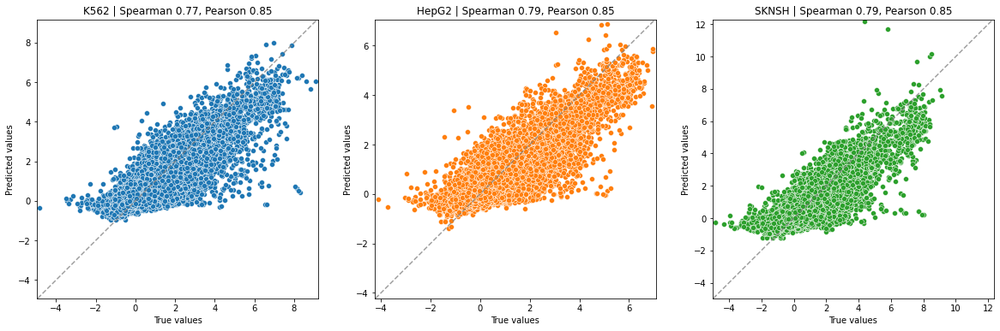


----------------------------------------------
Pearsons: [0.8536075621212013, 0.8524471888568881, 0.847540320570446], average: 0.85
Spearmans: [0.7747409686487537, 0.7899009489029882, 0.7927484427222397], average: 0.79
----------------------------------------------
Aggregate results for chromosome 5


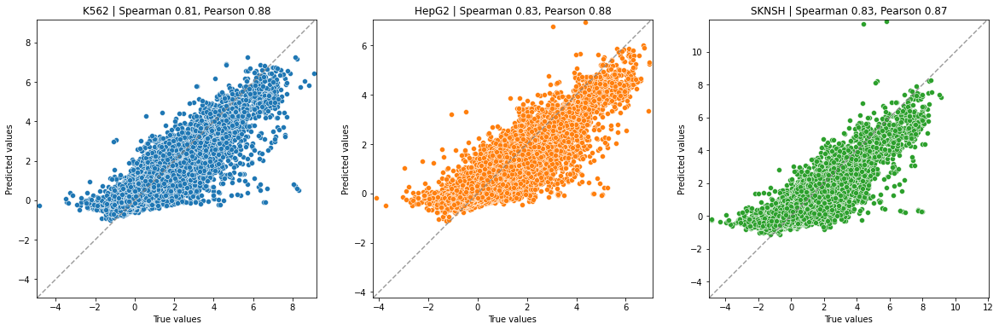

 45%|████▌     | 5/11 [28:16<33:55, 339.28s/it]


----------------------------------------------
Pearsons: [0.8831019116768901, 0.8837931811239381, 0.8734087060176172], average: 0.88
Spearmans: [0.8119668769213397, 0.8324354912537827, 0.8277637631212045], average: 0.82
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 692519 (87.37%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  90968 (11.48%)

Excluded from train: 0 (0.0)%
-------------------------------------------

archive unpacked in ./


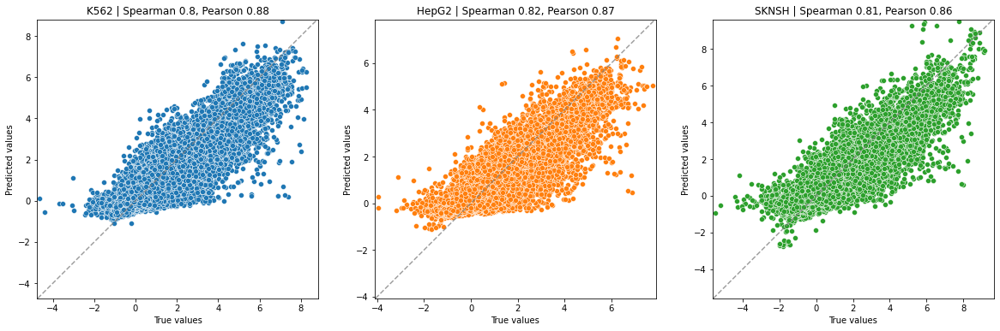


----------------------------------------------
Pearsons: [0.8759686824151607, 0.8704270499027918, 0.8642716857245276], average: 0.87
Spearmans: [0.7961187561709288, 0.8160961089211529, 0.8140028080517668], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_043920 in eval mode


archive unpacked in ./


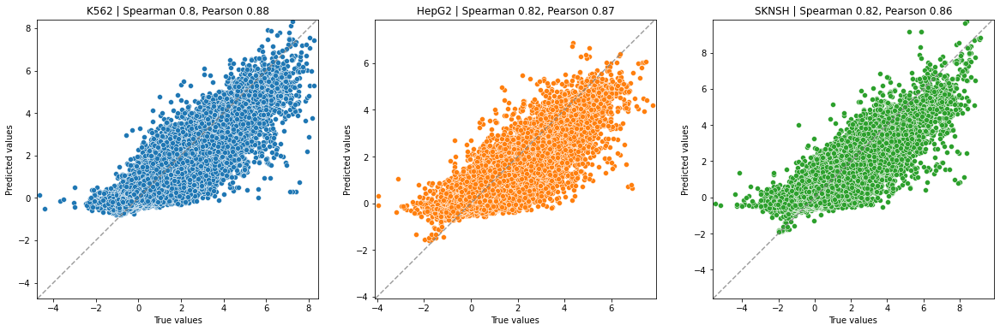


----------------------------------------------
Pearsons: [0.8773174958292111, 0.8684622165489863, 0.8649679843942193], average: 0.87
Spearmans: [0.8002388211142625, 0.8168392350626571, 0.8165974685154694], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_040520 in eval mode


archive unpacked in ./


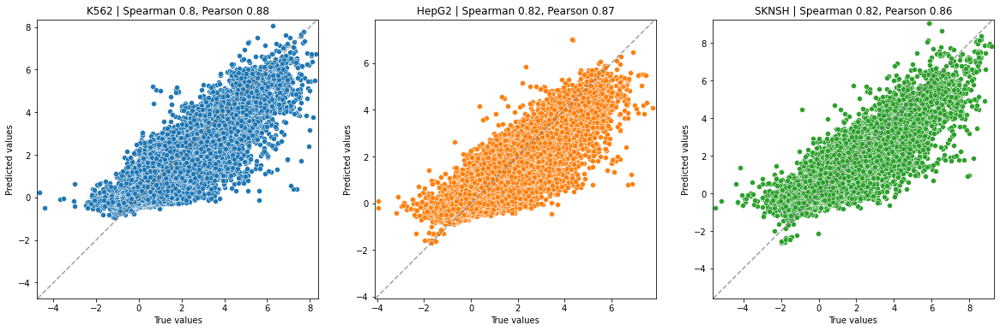


----------------------------------------------
Pearsons: [0.876436884811189, 0.8722824428726255, 0.8644373760236407], average: 0.87
Spearmans: [0.8000169542105005, 0.818395158157241, 0.8163097953271908], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_023213 in eval mode


archive unpacked in ./


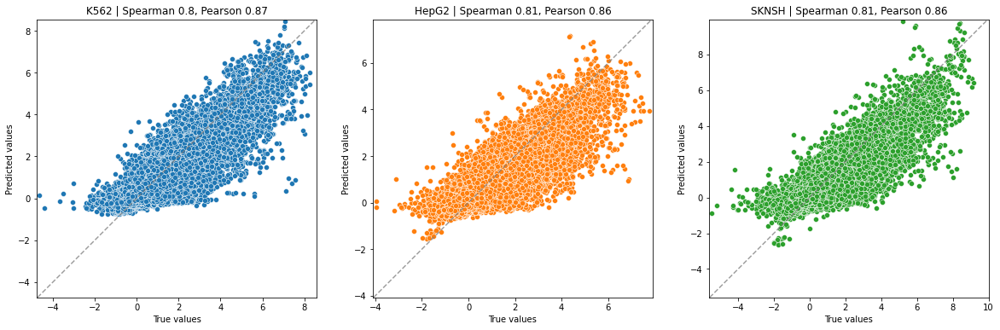


----------------------------------------------
Pearsons: [0.8748160734589698, 0.8647469908292011, 0.8591699606907304], average: 0.87
Spearmans: [0.7968578585079334, 0.8127233036611499, 0.8119287419370289], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_003816 in eval mode


archive unpacked in ./


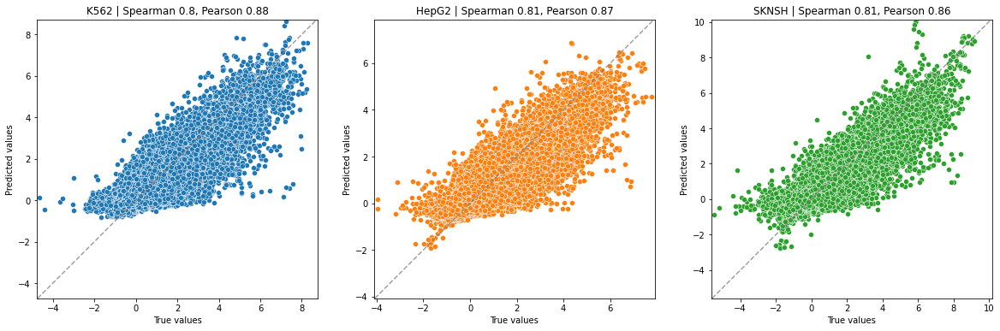


----------------------------------------------
Pearsons: [0.8784698345331813, 0.8687436359672094, 0.863359655675101], average: 0.87
Spearmans: [0.8000395525726516, 0.814598057014087, 0.8140128983997835], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_005837 in eval mode


archive unpacked in ./


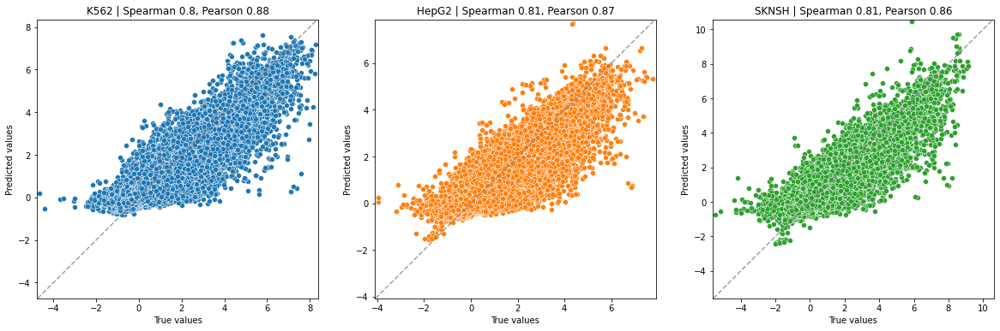


----------------------------------------------
Pearsons: [0.8778615854134469, 0.8687187885968036, 0.8634949110969918], average: 0.87
Spearmans: [0.7992282225708945, 0.8141401612518909, 0.8147926807167183], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_030053 in eval mode


archive unpacked in ./


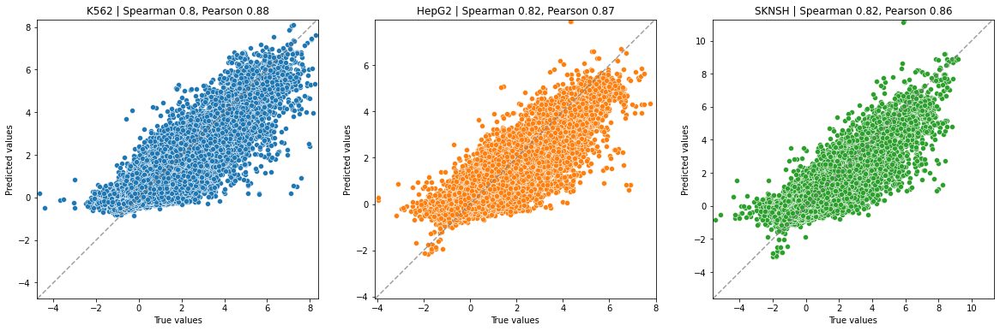


----------------------------------------------
Pearsons: [0.8765245027820928, 0.8711146237931598, 0.86474391998183], average: 0.87
Spearmans: [0.8012511677599424, 0.8181006751411355, 0.8179490683214378], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_005344 in eval mode


archive unpacked in ./


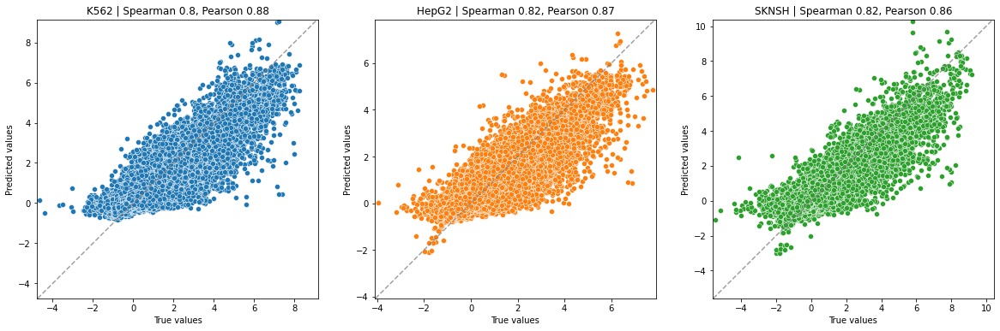


----------------------------------------------
Pearsons: [0.8767105916465323, 0.869171049282885, 0.8647227088809752], average: 0.87
Spearmans: [0.8006204750561674, 0.8180898685067616, 0.8172612361777102], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_010900 in eval mode


archive unpacked in ./


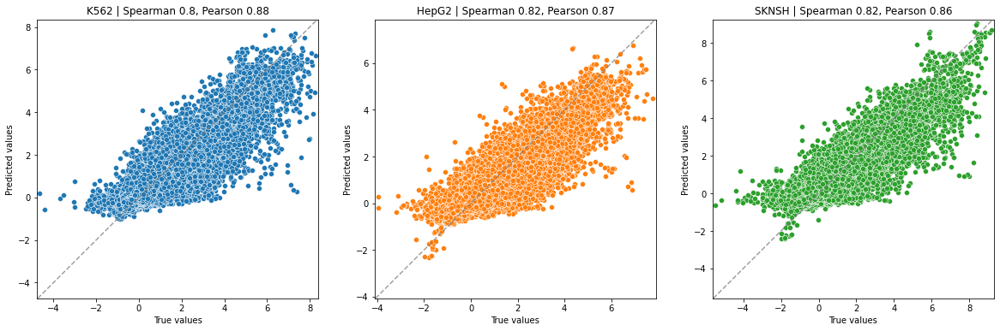


----------------------------------------------
Pearsons: [0.8773417640771111, 0.8722174418551041, 0.8636092030076272], average: 0.87
Spearmans: [0.798943759893623, 0.8178557908531194, 0.8166861633640454], average: 0.81
----------------------------------------------
on chromosome 6
reporting per model results
Loaded model from 20230112_040504 in eval mode


archive unpacked in ./


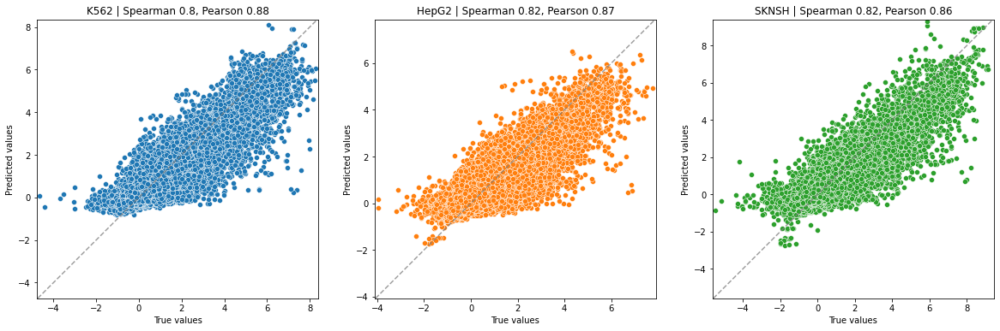


----------------------------------------------
Pearsons: [0.877661536049197, 0.8708997284906635, 0.8649431432983186], average: 0.87
Spearmans: [0.800032530451791, 0.8164604573780376, 0.817148667439755], average: 0.81
----------------------------------------------
Aggregate results for chromosome 6


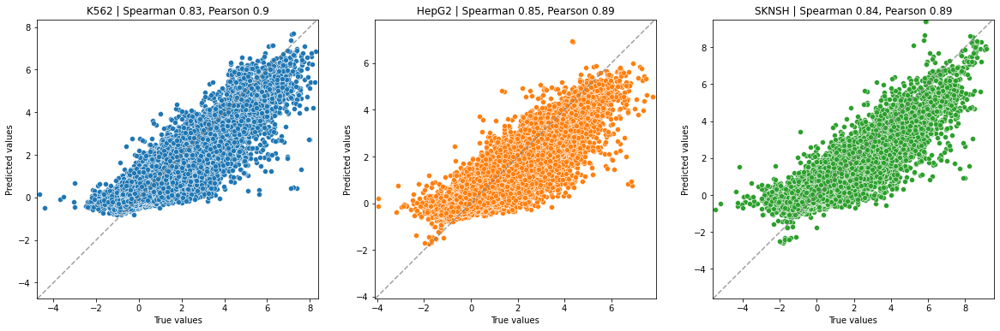

 55%|█████▍    | 6/11 [33:57<28:19, 339.96s/it]


----------------------------------------------
Pearsons: [0.9004129063433934, 0.8943970410573644, 0.8867146880975955], average: 0.89
Spearmans: [0.8288869403108013, 0.8481235506051654, 0.8438059456508841], average: 0.84
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 688751 (86.89%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  94736 (11.95%)

Excluded from train: 0 (0.0)%
-------------------------------------------

archive unpacked in ./


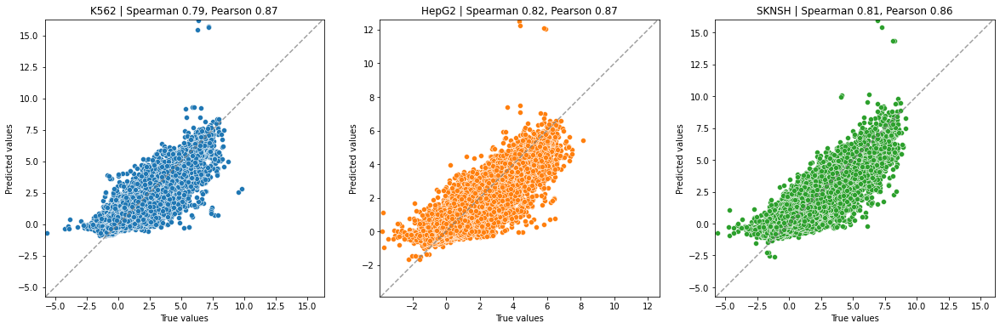


----------------------------------------------
Pearsons: [0.8698602795011929, 0.8698003325503977, 0.8612409331646558], average: 0.87
Spearmans: [0.7933154744992154, 0.8192008354612643, 0.8112919849285113], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_042513 in eval mode


archive unpacked in ./


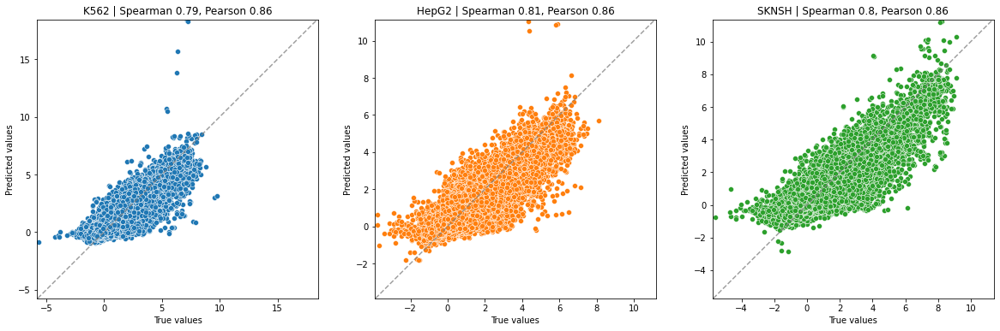


----------------------------------------------
Pearsons: [0.8644546936920934, 0.8631416349259833, 0.8573989333347077], average: 0.86
Spearmans: [0.7859396900616445, 0.8108678396548986, 0.8021280390684025], average: 0.8
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230111_234041 in eval mode


archive unpacked in ./


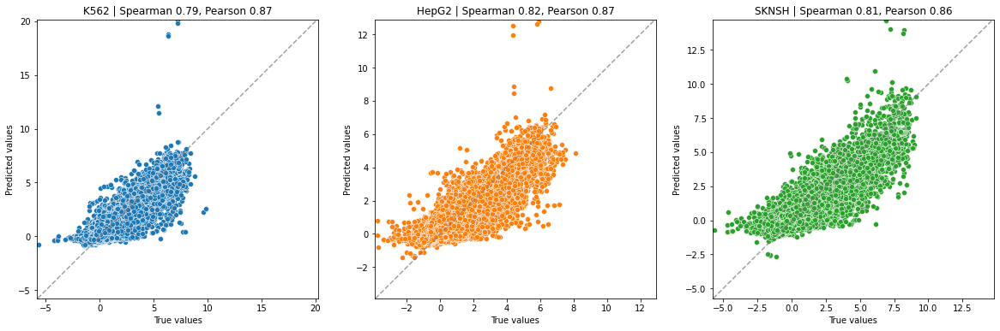


----------------------------------------------
Pearsons: [0.8664751184506556, 0.8661228784563471, 0.8597220681897694], average: 0.86
Spearmans: [0.793574556808907, 0.8190166895758635, 0.8112200445505281], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_015315 in eval mode


archive unpacked in ./


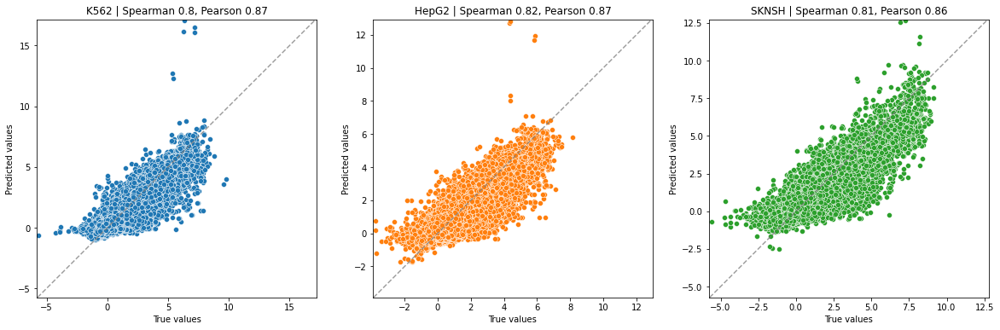


----------------------------------------------
Pearsons: [0.8698908569020094, 0.8681886077934124, 0.8602568638845166], average: 0.87
Spearmans: [0.7950623318340444, 0.8205797124011694, 0.8096588998253185], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_023015 in eval mode


archive unpacked in ./


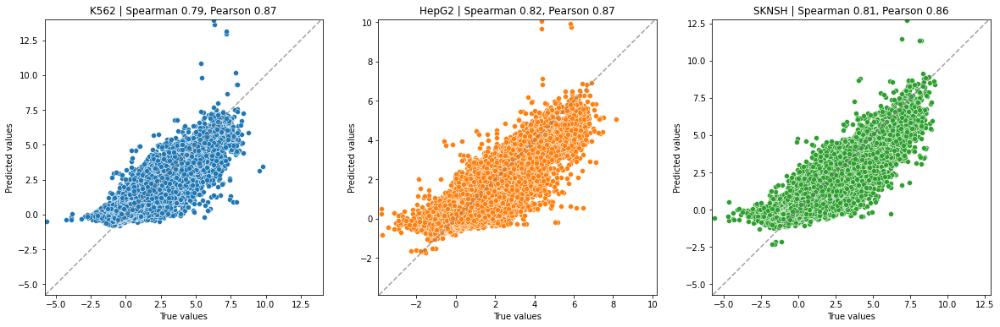


----------------------------------------------
Pearsons: [0.8719806827253059, 0.8696187483584714, 0.8645777973510295], average: 0.87
Spearmans: [0.7948682183532314, 0.818494181935028, 0.8104290648347383], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_032324 in eval mode


archive unpacked in ./


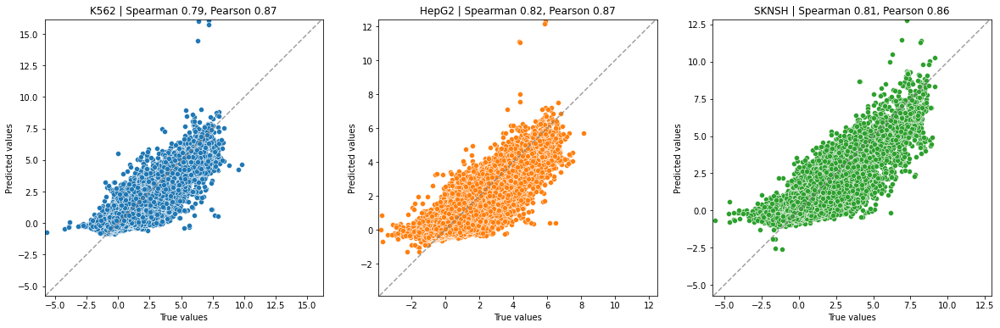


----------------------------------------------
Pearsons: [0.8711997085450136, 0.8678987741273372, 0.8626631017946397], average: 0.87
Spearmans: [0.7921459691549102, 0.8184482653090588, 0.8122946382653989], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_050443 in eval mode


archive unpacked in ./


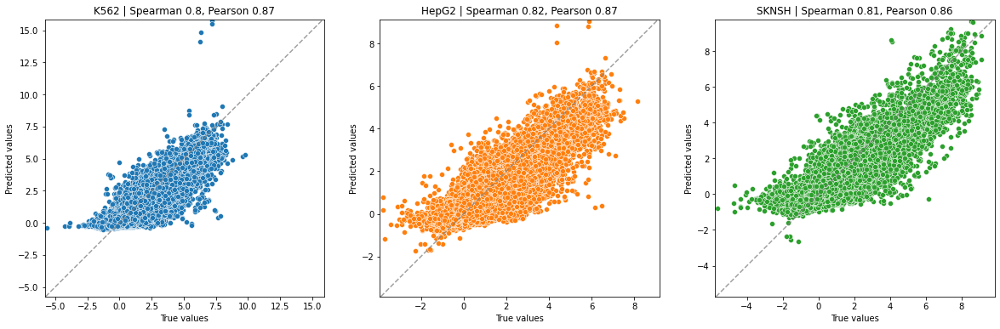


----------------------------------------------
Pearsons: [0.8703743048043323, 0.8715914930443337, 0.8647983739903247], average: 0.87
Spearmans: [0.7950739064143837, 0.820560888329117, 0.8121781539565844], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_023239 in eval mode


archive unpacked in ./


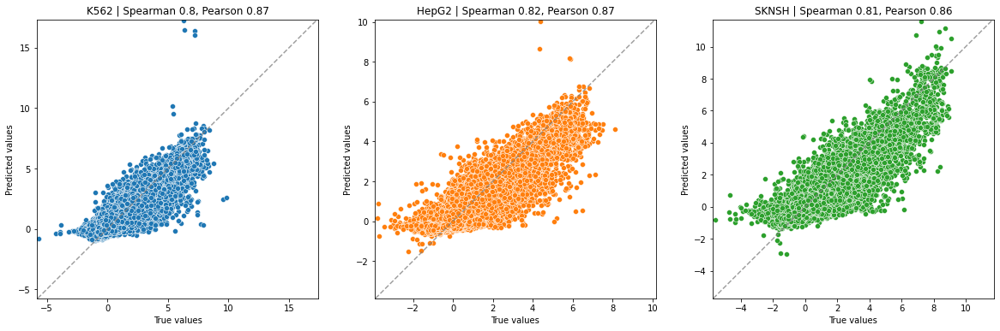


----------------------------------------------
Pearsons: [0.8717093773086786, 0.8695389575152985, 0.8634443630269619], average: 0.87
Spearmans: [0.7952251478014765, 0.8195539135114575, 0.8112114468220305], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_033504 in eval mode


archive unpacked in ./


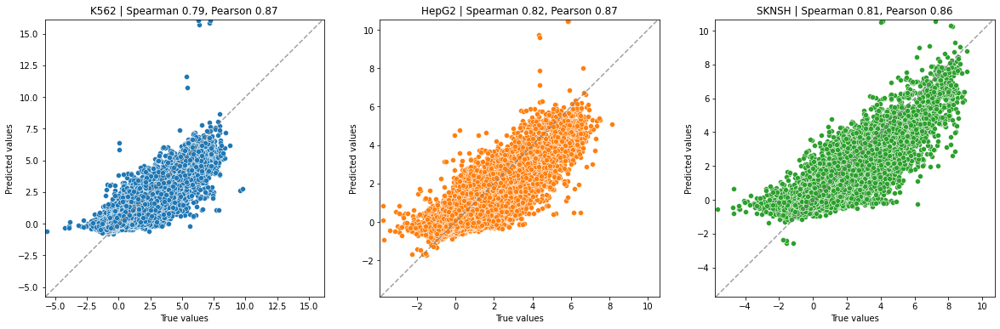


----------------------------------------------
Pearsons: [0.8670467604384318, 0.8675000373167507, 0.8610073310048002], average: 0.87
Spearmans: [0.7928628445445277, 0.8191485626894883, 0.8089149790337181], average: 0.81
----------------------------------------------
on chromosome 7
reporting per model results
Loaded model from 20230112_011949 in eval mode


archive unpacked in ./


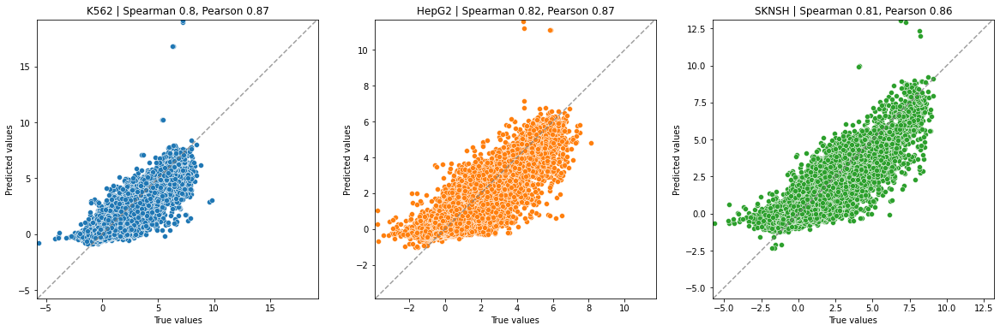


----------------------------------------------
Pearsons: [0.8701848293037326, 0.8687764592349099, 0.8637534725495913], average: 0.87
Spearmans: [0.795398455182055, 0.8200720818924786, 0.8128262201180932], average: 0.81
----------------------------------------------
Aggregate results for chromosome 7


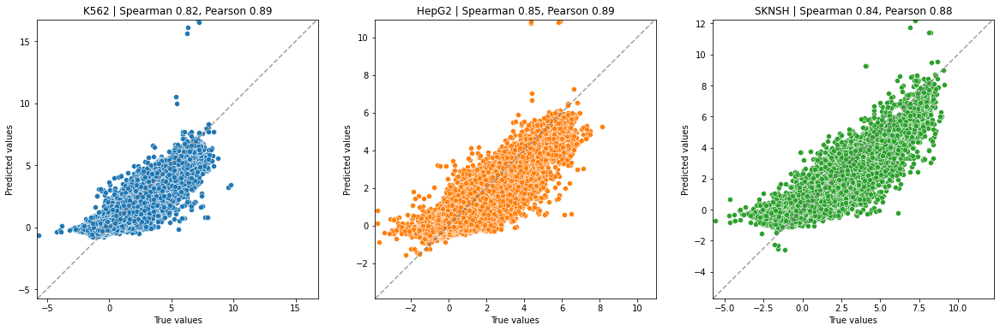

 64%|██████▎   | 7/11 [39:45<22:50, 342.68s/it]


----------------------------------------------
Pearsons: [0.8926690686337609, 0.8931000157168572, 0.8847509195870282], average: 0.89
Spearmans: [0.8238730543069187, 0.8506971187732876, 0.8391577863396643], average: 0.84
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 708366 (89.37%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  75121 (9.48%)

Excluded from train: 0 (0.0)%
--------------------------------------------

archive unpacked in ./


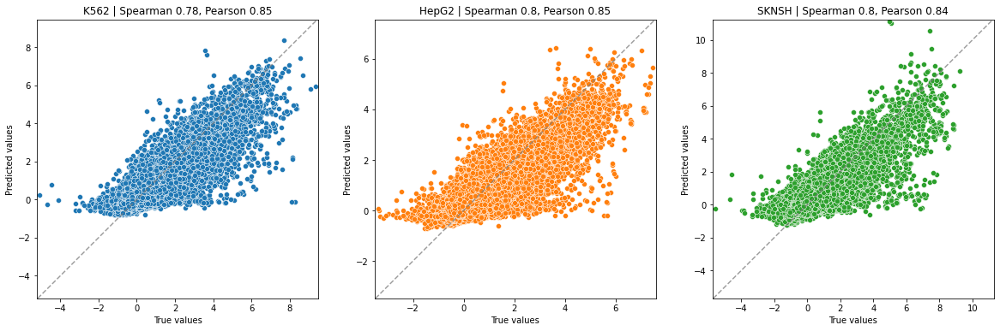


----------------------------------------------
Pearsons: [0.8535797113655171, 0.8510094424370273, 0.843822524338932], average: 0.85
Spearmans: [0.7803222013052051, 0.7985701386211076, 0.8005453974875546], average: 0.79
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230111_235235 in eval mode


archive unpacked in ./


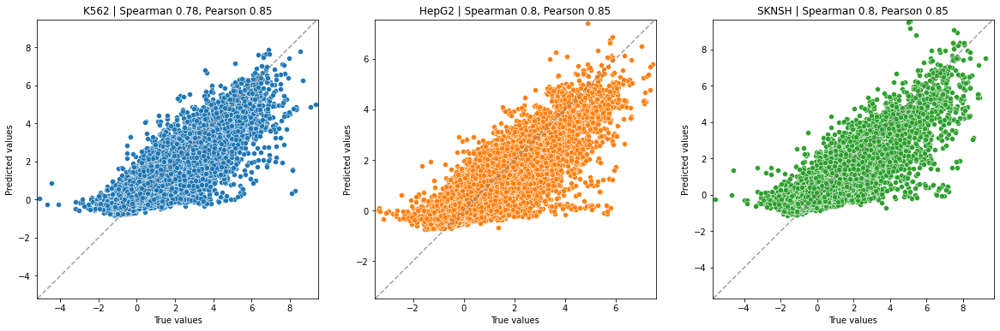


----------------------------------------------
Pearsons: [0.8548896467774807, 0.8527170202753769, 0.8464436074326473], average: 0.85
Spearmans: [0.7819543958683767, 0.8026781764229403, 0.8020715913296764], average: 0.8
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230112_032522 in eval mode


archive unpacked in ./


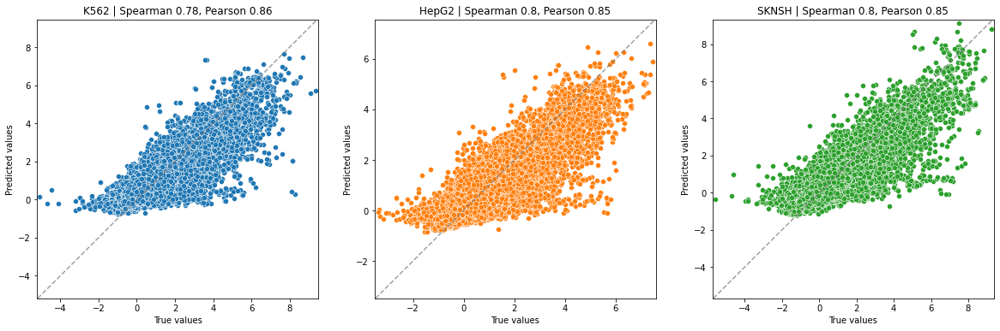


----------------------------------------------
Pearsons: [0.859842031934736, 0.8549414628518573, 0.8474016760878255], average: 0.85
Spearmans: [0.7831994978869699, 0.8044559489834368, 0.8021376323049068], average: 0.8
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230112_010218 in eval mode


archive unpacked in ./


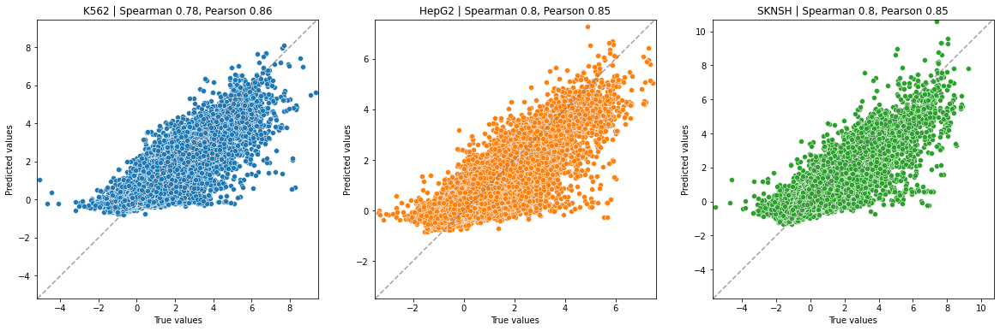


----------------------------------------------
Pearsons: [0.8576598235152553, 0.8537999241998778, 0.8452319827486641], average: 0.85
Spearmans: [0.7825879817090575, 0.8015570666499438, 0.8006400665316414], average: 0.79
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230112_011225 in eval mode


archive unpacked in ./


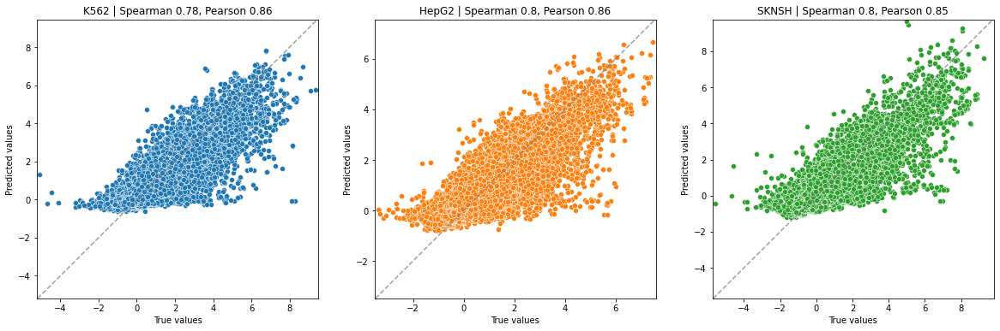


----------------------------------------------
Pearsons: [0.857351150408804, 0.8557067964870188, 0.8483951517685641], average: 0.85
Spearmans: [0.7826902834469716, 0.8043272620300237, 0.8023634730958135], average: 0.8
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230112_034146 in eval mode


archive unpacked in ./


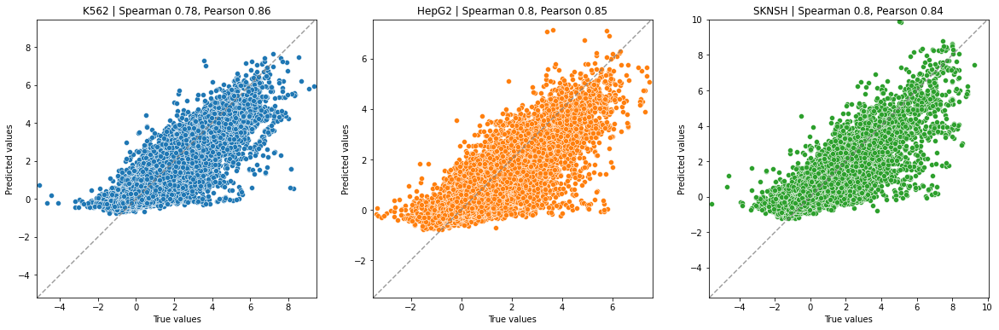


----------------------------------------------
Pearsons: [0.8574219332878168, 0.85130760275179, 0.8431084251382788], average: 0.85
Spearmans: [0.7825718308673657, 0.8027695124418364, 0.80160181103439], average: 0.8
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230112_032715 in eval mode


archive unpacked in ./


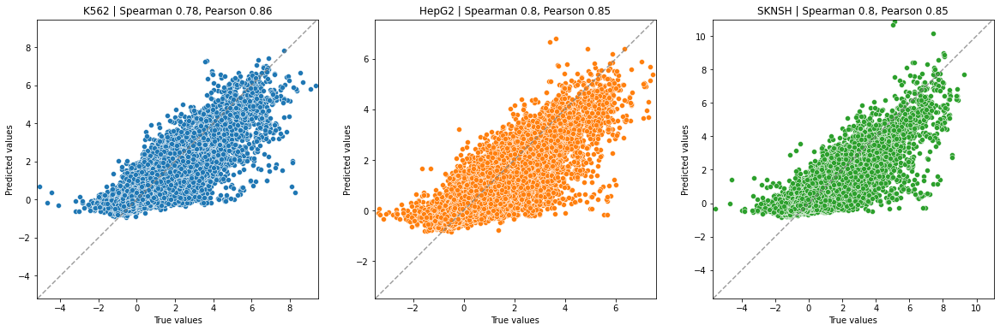


----------------------------------------------
Pearsons: [0.8563477865902516, 0.8540409360937212, 0.8469568253625115], average: 0.85
Spearmans: [0.7805955264219712, 0.8028139514206903, 0.8027478712148922], average: 0.8
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230112_035958 in eval mode


archive unpacked in ./


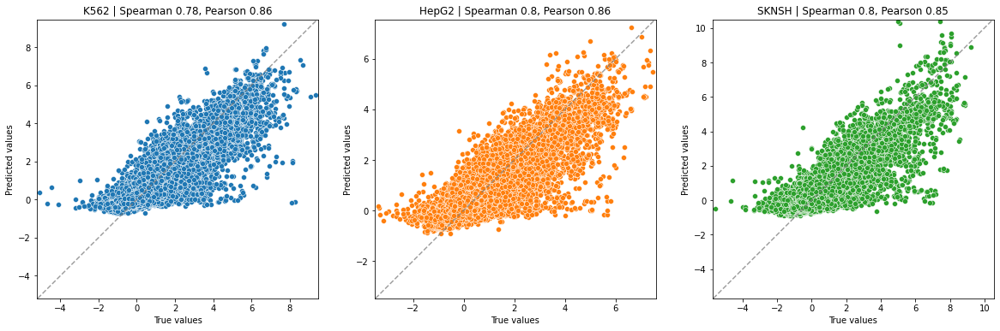


----------------------------------------------
Pearsons: [0.858861907351366, 0.8552470378848811, 0.846902135153999], average: 0.85
Spearmans: [0.7821036322694332, 0.8049638896387499, 0.8030819049128002], average: 0.8
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230111_231916 in eval mode


archive unpacked in ./


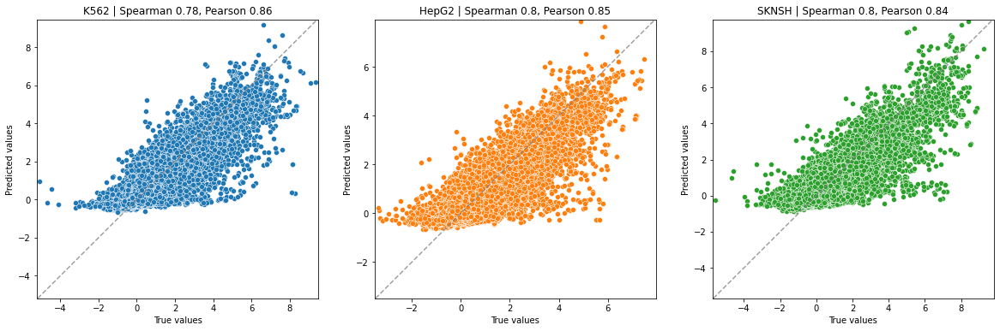


----------------------------------------------
Pearsons: [0.8572069588875323, 0.8541961207538963, 0.8445118583488306], average: 0.85
Spearmans: [0.7821114651532111, 0.7993402171232816, 0.7975017686737449], average: 0.79
----------------------------------------------
on chromosome 8
reporting per model results
Loaded model from 20230112_082925 in eval mode


archive unpacked in ./


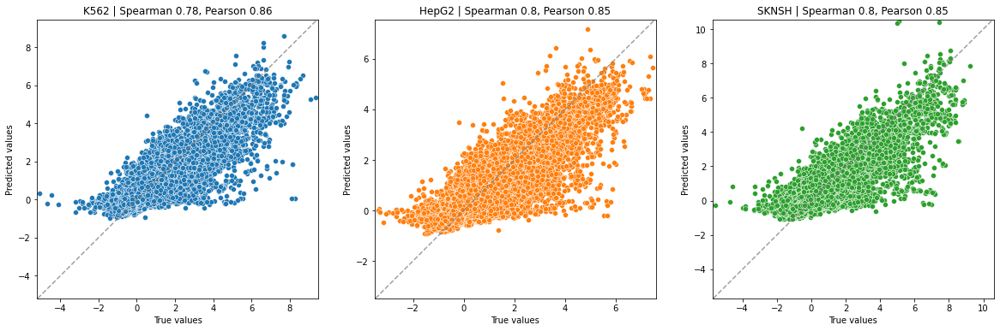


----------------------------------------------
Pearsons: [0.8590374188639537, 0.8525732026999215, 0.8466789100001023], average: 0.85
Spearmans: [0.7809604645300625, 0.8023981368436257, 0.8021510580725822], average: 0.8
----------------------------------------------
Aggregate results for chromosome 8


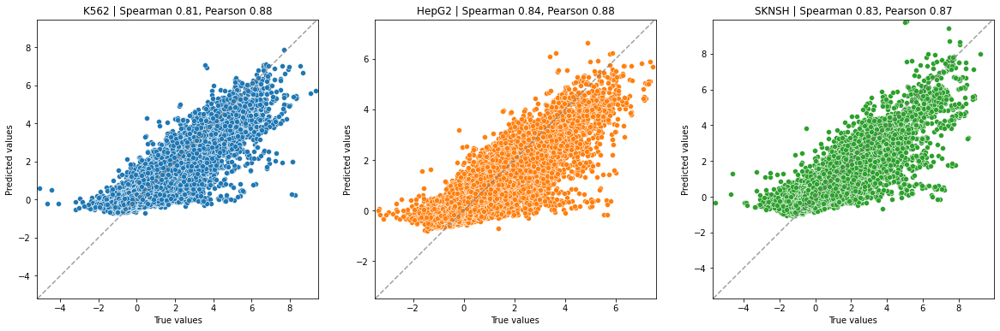

 73%|███████▎  | 8/11 [45:29<17:09, 343.07s/it]


----------------------------------------------
Pearsons: [0.8820262760271287, 0.8792655220040423, 0.8690912161753712], average: 0.88
Spearmans: [0.8132644835549635, 0.8356481357070789, 0.830747821414097], average: 0.83
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 712035 (89.83%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  71452 (9.01%)

Excluded from train: 0 (0.0)%
---------------------------------------------

archive unpacked in ./


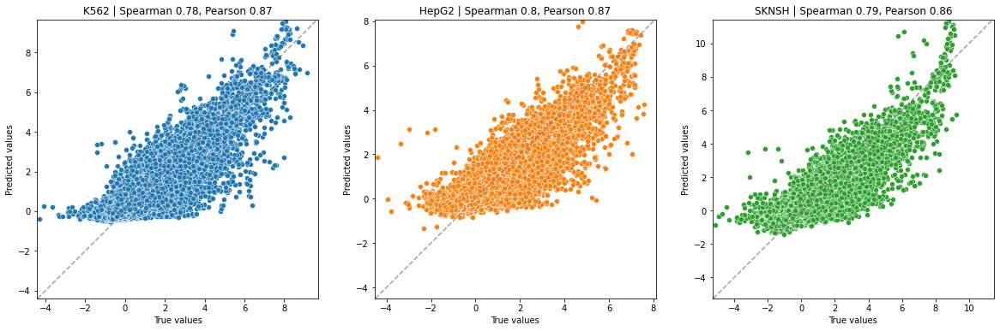


----------------------------------------------
Pearsons: [0.8713963978762413, 0.8652146093352651, 0.8601663538082617], average: 0.87
Spearmans: [0.782714041292907, 0.8021921581537002, 0.7945392772107457], average: 0.79
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_012316 in eval mode


archive unpacked in ./


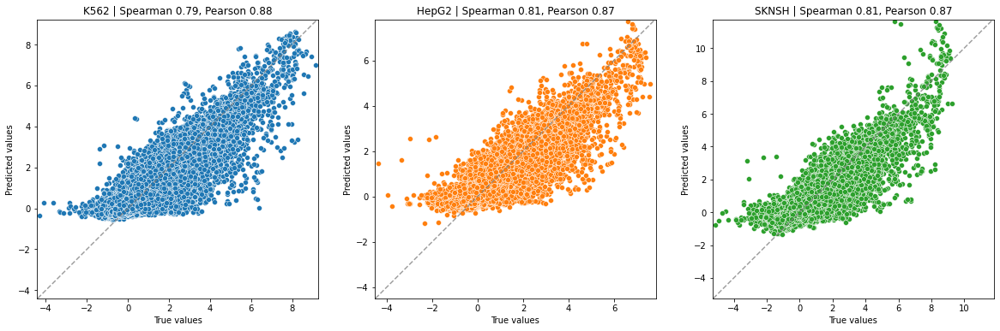


----------------------------------------------
Pearsons: [0.8786377997578712, 0.8724040531550544, 0.8656165217786289], average: 0.87
Spearmans: [0.7909664559060381, 0.8132699974548735, 0.8051183377371182], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_030608 in eval mode


archive unpacked in ./


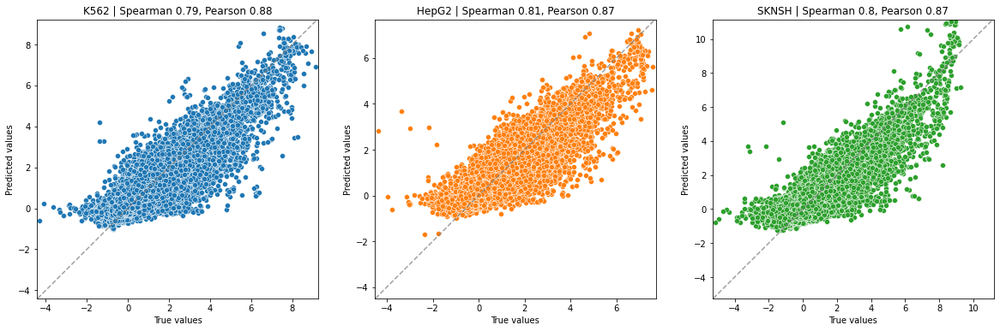


----------------------------------------------
Pearsons: [0.8803198280937077, 0.8729449629661499, 0.8669790963976349], average: 0.87
Spearmans: [0.7928239122646235, 0.8121789465203212, 0.803116191255624], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_004715 in eval mode


archive unpacked in ./


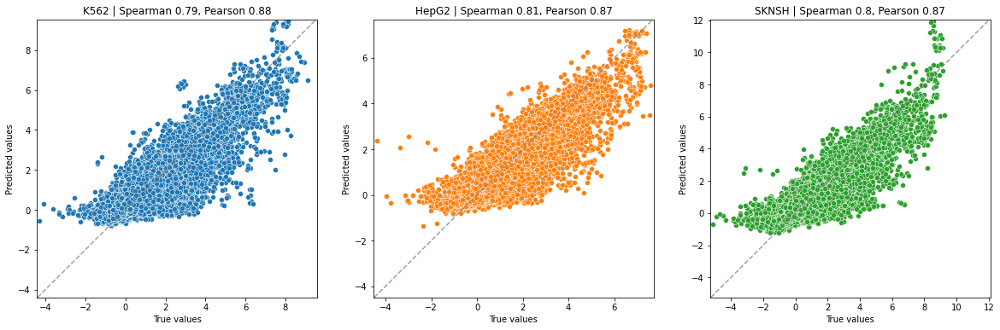


----------------------------------------------
Pearsons: [0.8792356994905155, 0.8722694488109429, 0.8662543532692332], average: 0.87
Spearmans: [0.7931576955533424, 0.8106870149185624, 0.8023025781843539], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_004934 in eval mode


archive unpacked in ./


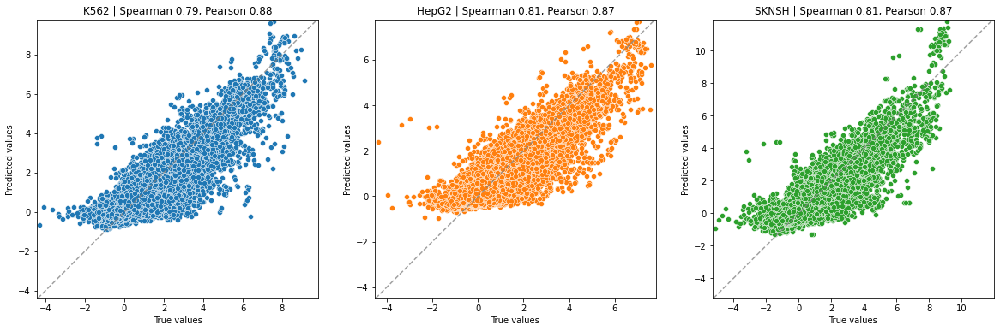


----------------------------------------------
Pearsons: [0.8817206197402174, 0.8740292430336553, 0.8666788208948724], average: 0.87
Spearmans: [0.7939616422688907, 0.8137989628463916, 0.8050901982069578], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_045850 in eval mode


archive unpacked in ./


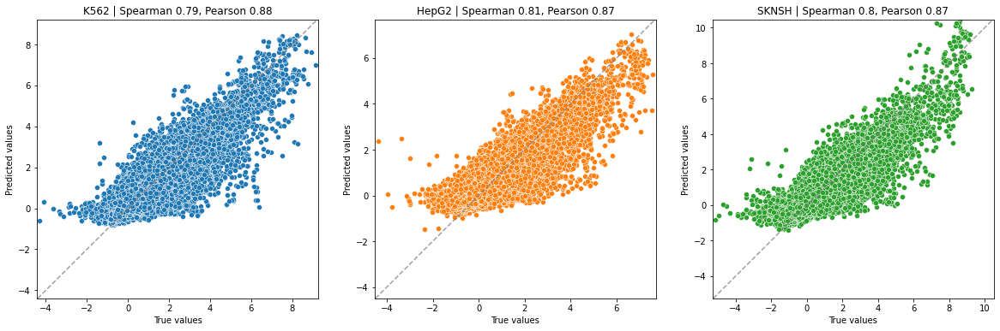


----------------------------------------------
Pearsons: [0.8800032704179046, 0.8743142973005733, 0.868159678183792], average: 0.87
Spearmans: [0.792942027202665, 0.8130297580234346, 0.8048913120302483], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_053708 in eval mode


archive unpacked in ./


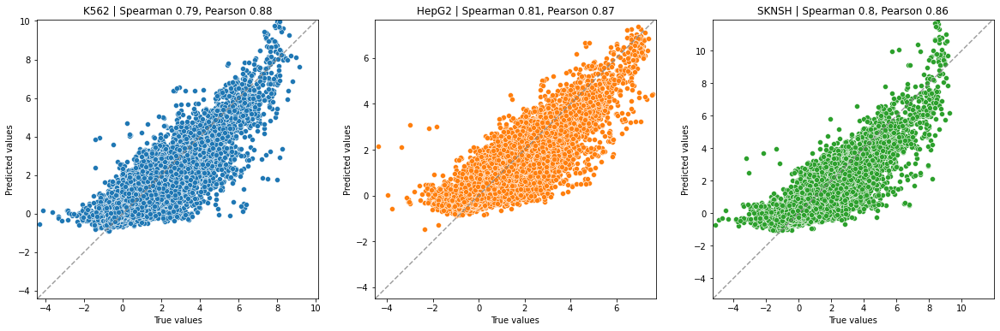


----------------------------------------------
Pearsons: [0.879342376191454, 0.8740974016970039, 0.864559395448143], average: 0.87
Spearmans: [0.7923908696436398, 0.8115059893183321, 0.8043314977412348], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_051056 in eval mode


archive unpacked in ./


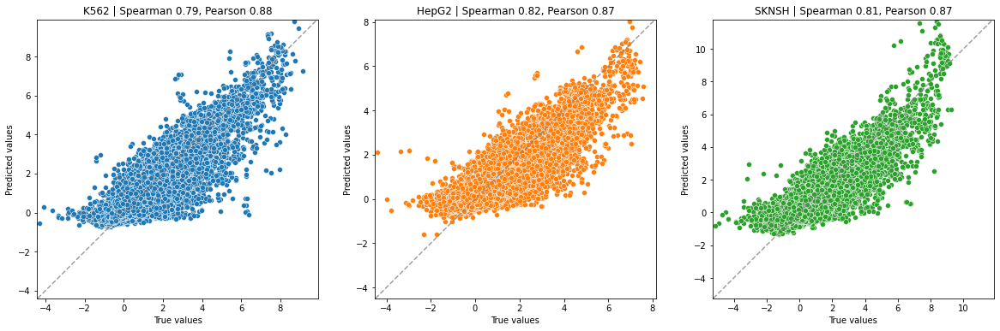


----------------------------------------------
Pearsons: [0.8802626914919464, 0.8740361555285598, 0.8679510344961512], average: 0.87
Spearmans: [0.7931263736399429, 0.8154416082527474, 0.806184171102238], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_010359 in eval mode


archive unpacked in ./


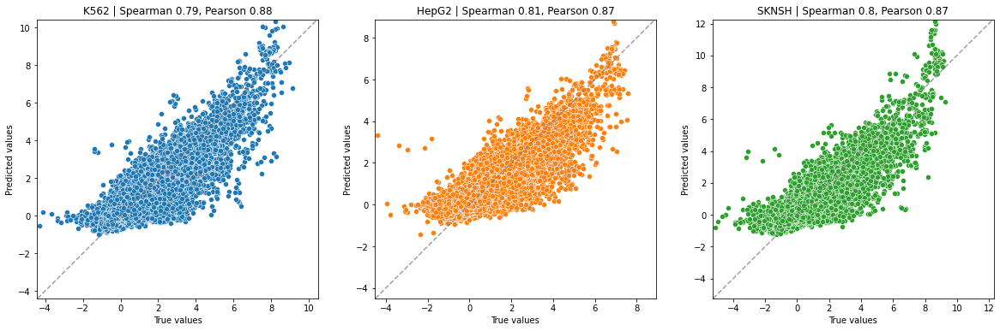


----------------------------------------------
Pearsons: [0.8803947177856901, 0.8731154315210893, 0.8658361133214856], average: 0.87
Spearmans: [0.7929656593908082, 0.8136208187704977, 0.8047281029909684], average: 0.8
----------------------------------------------
on chromosome 9
reporting per model results
Loaded model from 20230112_023617 in eval mode


archive unpacked in ./


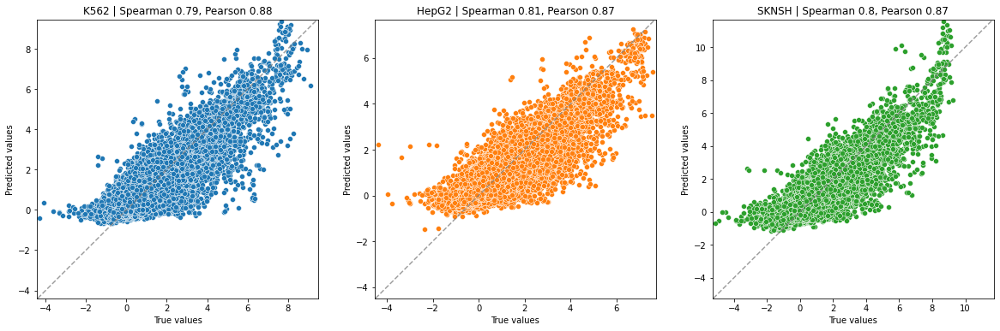


----------------------------------------------
Pearsons: [0.8764725314618471, 0.8696216197553721, 0.8655528678519656], average: 0.87
Spearmans: [0.7882243339140699, 0.8079219938574527, 0.801391540331515], average: 0.8
----------------------------------------------
Aggregate results for chromosome 9


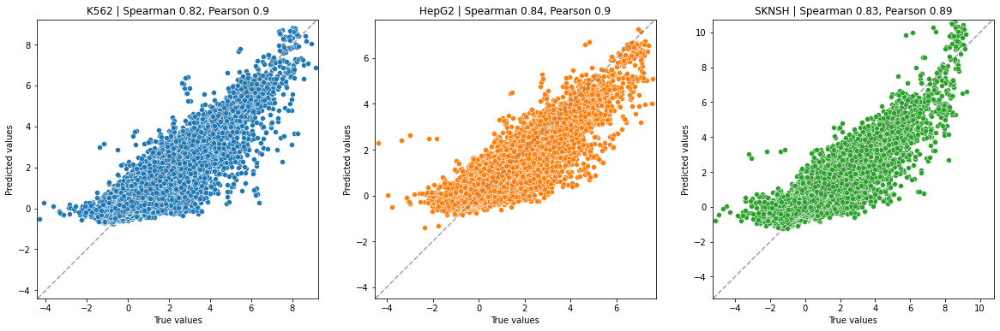

 82%|████████▏ | 9/11 [51:05<11:21, 340.92s/it]


----------------------------------------------
Pearsons: [0.9006075241928996, 0.8959132530751237, 0.8862563937111353], average: 0.89
Spearmans: [0.8213929326247587, 0.8435703830679796, 0.8315878163761068], average: 0.83
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 711834 (89.81%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  71653 (9.04%)

Excluded from train: 0 (0.0)%
--------------------------------------------

archive unpacked in ./


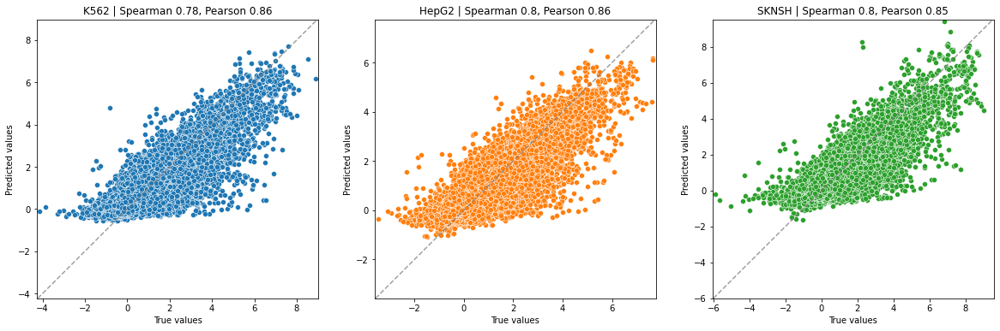


----------------------------------------------
Pearsons: [0.86210780945689, 0.8612443457549156, 0.8489122868599536], average: 0.86
Spearmans: [0.7839264496651577, 0.8048814931867125, 0.8000590427163863], average: 0.8
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230112_023138 in eval mode


archive unpacked in ./


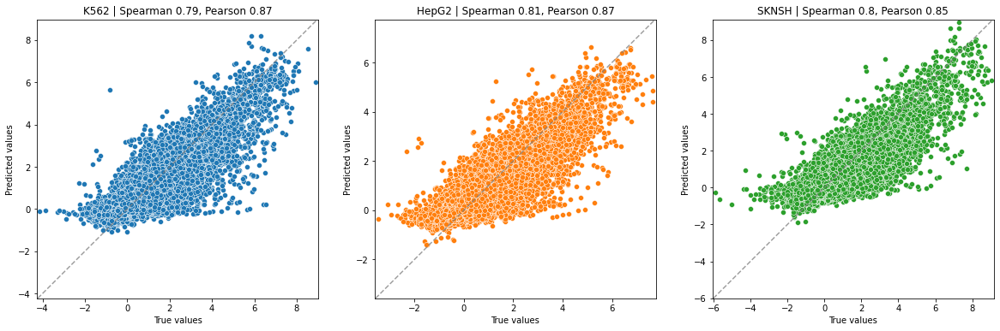


----------------------------------------------
Pearsons: [0.8653500553643845, 0.8658155157901827, 0.8549851930323669], average: 0.86
Spearmans: [0.7870152492276384, 0.8071123950922199, 0.8034509598906702], average: 0.8
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230111_235821 in eval mode


archive unpacked in ./


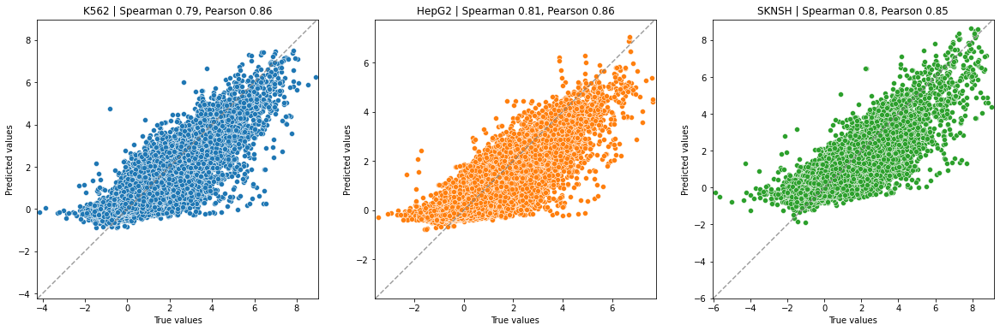


----------------------------------------------
Pearsons: [0.8632856253040501, 0.8609978853436739, 0.8516391291505443], average: 0.86
Spearmans: [0.7855216311216785, 0.8055909969016121, 0.8012647458766049], average: 0.8
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230112_035135 in eval mode


archive unpacked in ./


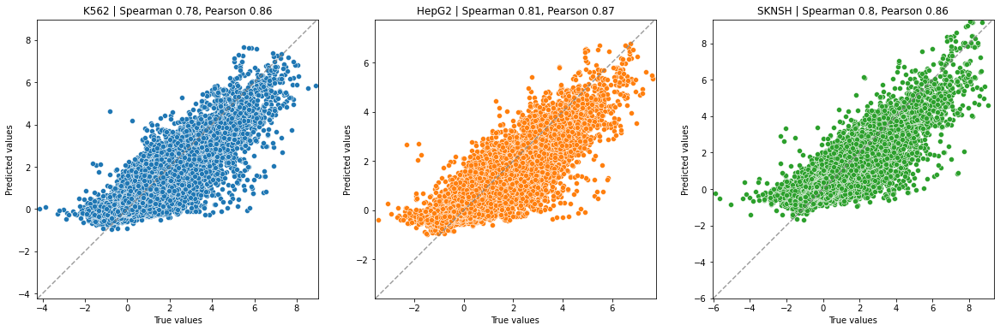


----------------------------------------------
Pearsons: [0.8638298637993249, 0.8657937792206812, 0.8559384571636156], average: 0.86
Spearmans: [0.7834862891329724, 0.8088155053846291, 0.804948381696743], average: 0.8
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230111_233239 in eval mode


archive unpacked in ./


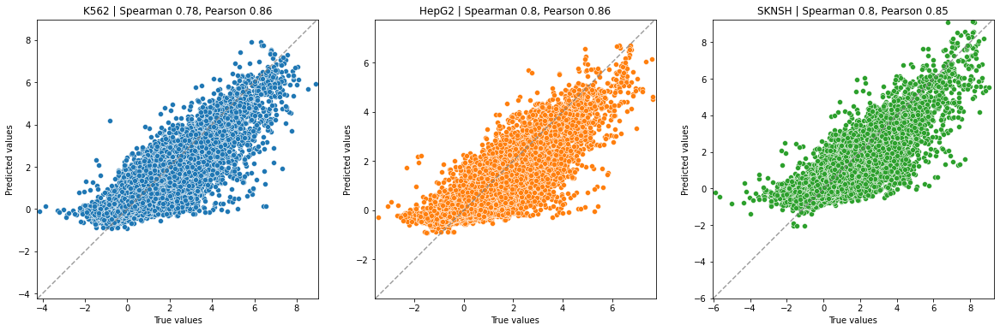


----------------------------------------------
Pearsons: [0.863381812707534, 0.8602496280976781, 0.8523571680198496], average: 0.86
Spearmans: [0.7806699418544525, 0.7998911684001113, 0.8003597465383383], average: 0.79
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230112_020147 in eval mode


archive unpacked in ./


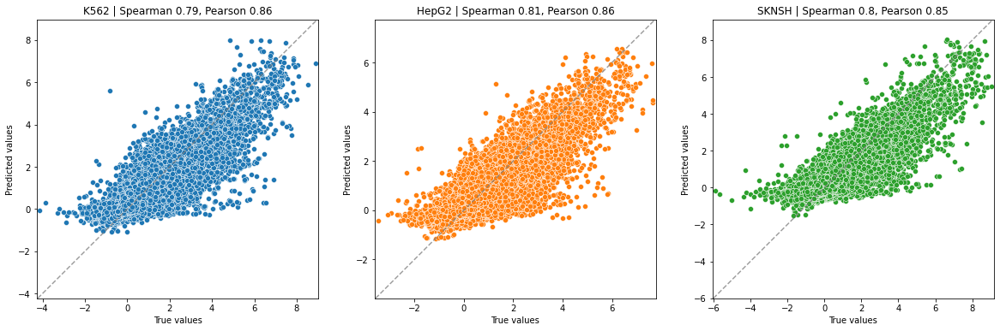


----------------------------------------------
Pearsons: [0.8631042952189946, 0.864086423657129, 0.8514871500252442], average: 0.86
Spearmans: [0.7858481026811225, 0.8073403869399035, 0.7991644203768603], average: 0.8
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230112_012222 in eval mode


archive unpacked in ./


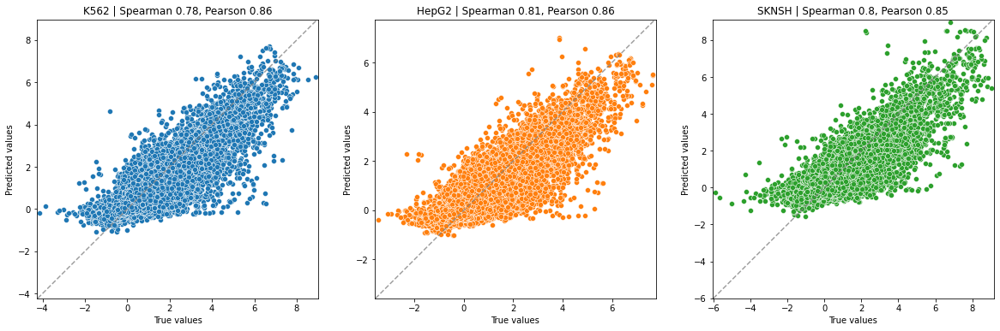


----------------------------------------------
Pearsons: [0.8634304431104874, 0.862014993641778, 0.8499180316190027], average: 0.86
Spearmans: [0.7836698006319479, 0.8069231912625644, 0.8017929526130503], average: 0.8
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230112_012717 in eval mode


archive unpacked in ./


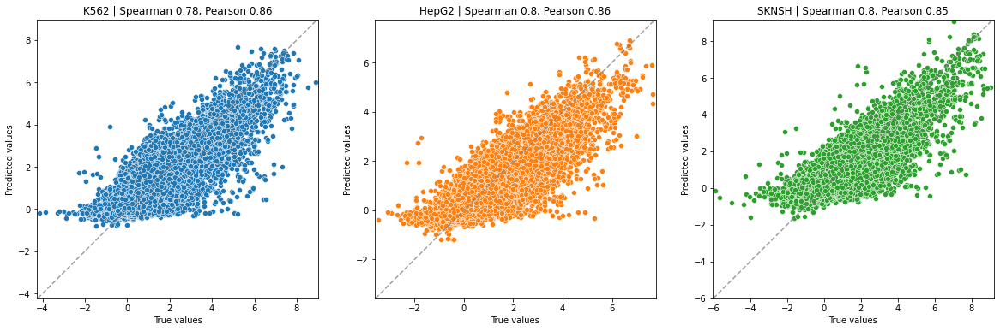


----------------------------------------------
Pearsons: [0.8586211632261247, 0.8584588305359349, 0.847948605366647], average: 0.86
Spearmans: [0.7781692241858505, 0.7992299948585774, 0.7964815889100569], average: 0.79
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230111_234320 in eval mode


archive unpacked in ./


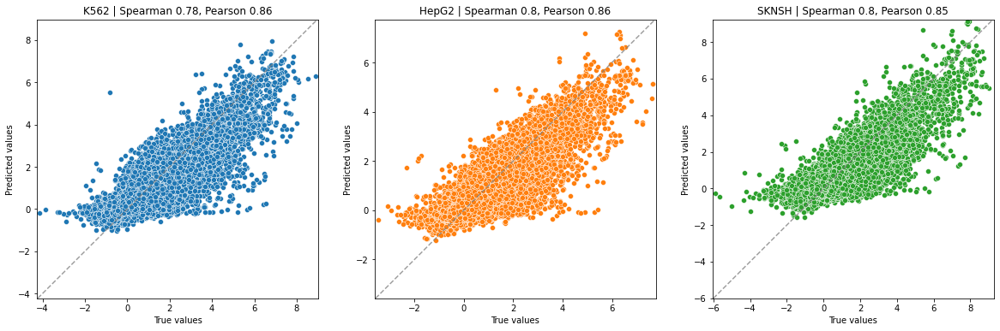


----------------------------------------------
Pearsons: [0.8623981294246021, 0.8613073034257945, 0.8513270234398811], average: 0.86
Spearmans: [0.7841808817202016, 0.8040035476607746, 0.8013913438677323], average: 0.8
----------------------------------------------
on chromosome 10
reporting per model results
Loaded model from 20230112_023108 in eval mode


archive unpacked in ./


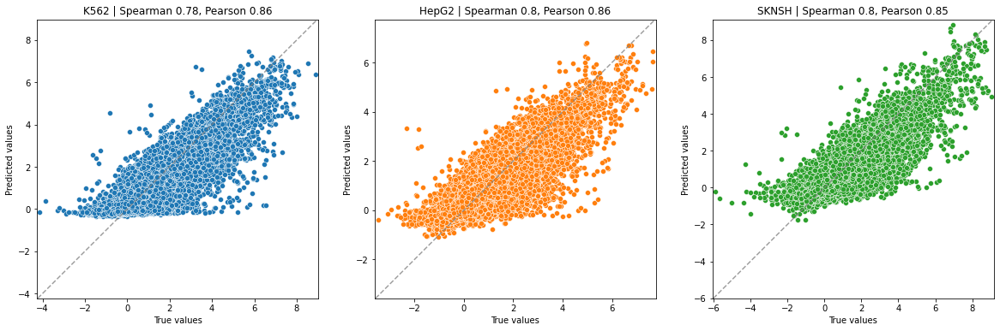


----------------------------------------------
Pearsons: [0.8631399255438995, 0.8613288537256444, 0.8524685863310841], average: 0.86
Spearmans: [0.7846484989462603, 0.8042771128258593, 0.8014034304446506], average: 0.8
----------------------------------------------
Aggregate results for chromosome 10


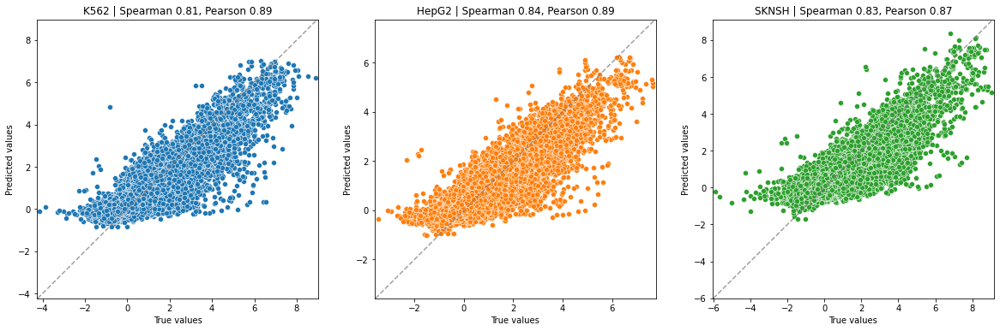

 91%|█████████ | 10/11 [56:43<05:39, 339.84s/it]


----------------------------------------------
Pearsons: [0.8876329229212873, 0.8877558562090518, 0.8745618118137091], average: 0.88
Spearmans: [0.8148694849827256, 0.8379013097170207, 0.8304157769086697], average: 0.83
----------------------------------------------
--------------------------------------------------

K562 | top cut value: 11.47, bottom cut value: -6.47
HepG2 | top cut value: 10.67, bottom cut value: -5.75
SKNSH | top cut value: 11.33, bottom cut value: -6.5

Number of examples discarded from top: 0
Number of examples discarded from bottom: 6

Number of examples available: 792635

--------------------------------------------------

Padding sequences... 

Creating train/val/test datasets with tokenized sequences... 

--------------------------------------------------

Number of examples in train: 689768 (87.02%)
Number of examples in val:   9148 (1.15%)
Number of examples in test:  93719 (11.82%)

Excluded from train: 0 (0.0)%
-------------------------------------------

archive unpacked in ./


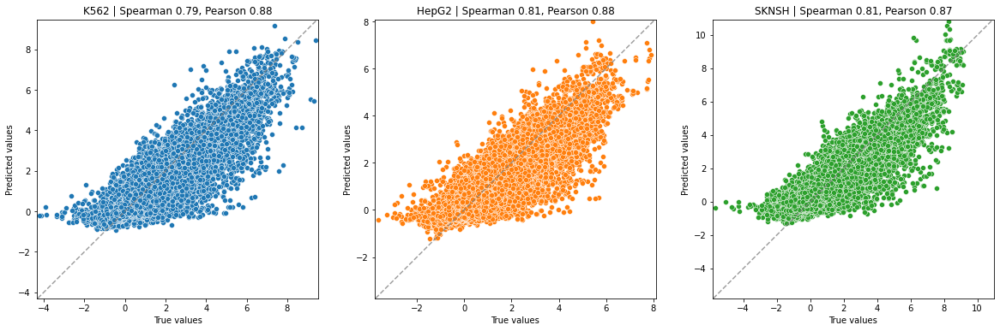


----------------------------------------------
Pearsons: [0.8781165826292698, 0.8757388690256505, 0.8682199880178655], average: 0.87
Spearmans: [0.7935506179515174, 0.8142310012100376, 0.8075356878349655], average: 0.81
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230112_023851 in eval mode


archive unpacked in ./


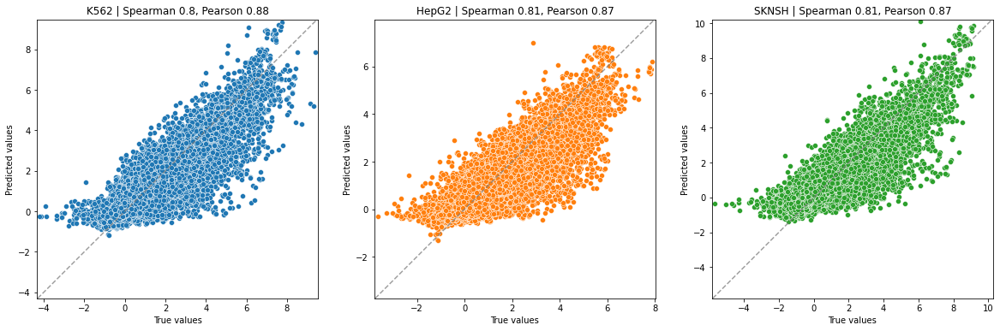


----------------------------------------------
Pearsons: [0.880665713790729, 0.8739573683823102, 0.8663377687535186], average: 0.87
Spearmans: [0.7972521708656961, 0.8130088174330259, 0.8079788688294087], average: 0.81
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230112_005738 in eval mode


archive unpacked in ./


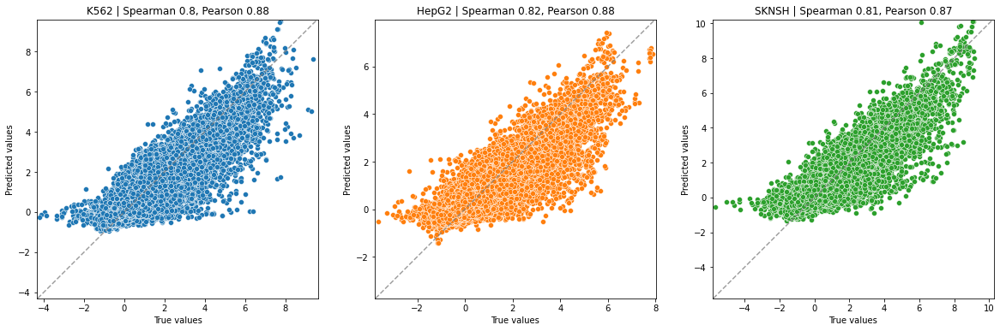


----------------------------------------------
Pearsons: [0.8820501252869198, 0.8755268780179647, 0.8698433699446088], average: 0.88
Spearmans: [0.796933875956918, 0.8153414469941554, 0.8112352589014992], average: 0.81
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230112_040839 in eval mode


archive unpacked in ./


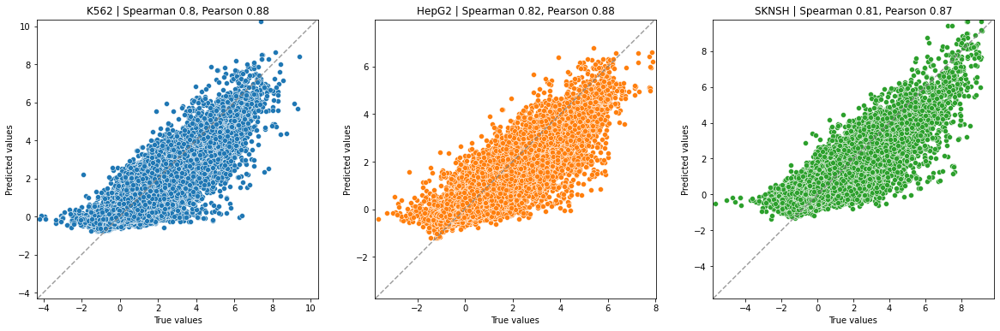


----------------------------------------------
Pearsons: [0.8806217670809291, 0.875475165774148, 0.8678326981174758], average: 0.87
Spearmans: [0.7956197763831467, 0.8161761761090862, 0.8091284675832099], average: 0.81
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230112_001449 in eval mode


archive unpacked in ./


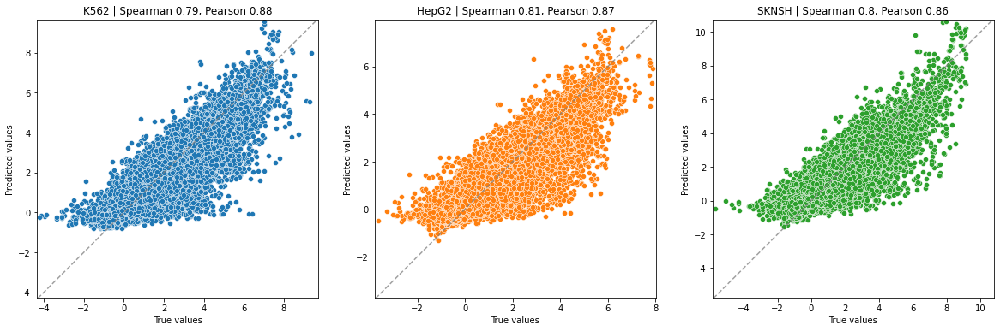


----------------------------------------------
Pearsons: [0.8763856735831417, 0.8686707984759419, 0.8636520597754473], average: 0.87
Spearmans: [0.7897230996228662, 0.8069563769101842, 0.8040757809883569], average: 0.8
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230111_233248 in eval mode


archive unpacked in ./


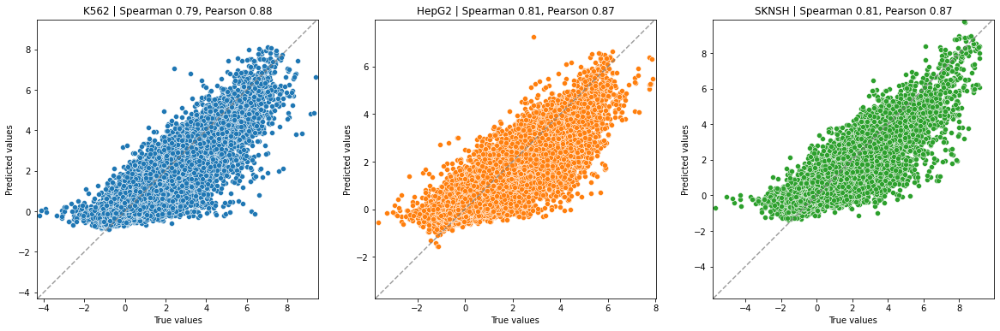


----------------------------------------------
Pearsons: [0.8806582845613036, 0.8735333926085465, 0.8669668283001041], average: 0.87
Spearmans: [0.7941245319057499, 0.8131920274537692, 0.8097204225361032], average: 0.81
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230111_235956 in eval mode


archive unpacked in ./


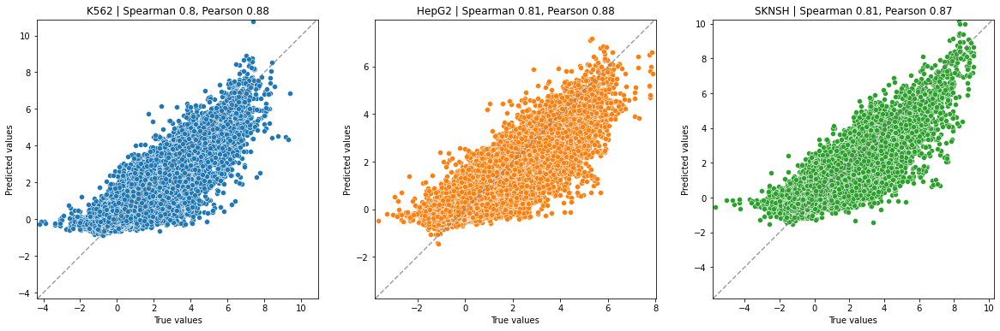


----------------------------------------------
Pearsons: [0.8804622171287981, 0.8751081038531906, 0.8657811647325695], average: 0.87
Spearmans: [0.7956959026101841, 0.8134939262751008, 0.8057520228319559], average: 0.8
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230111_234647 in eval mode


archive unpacked in ./


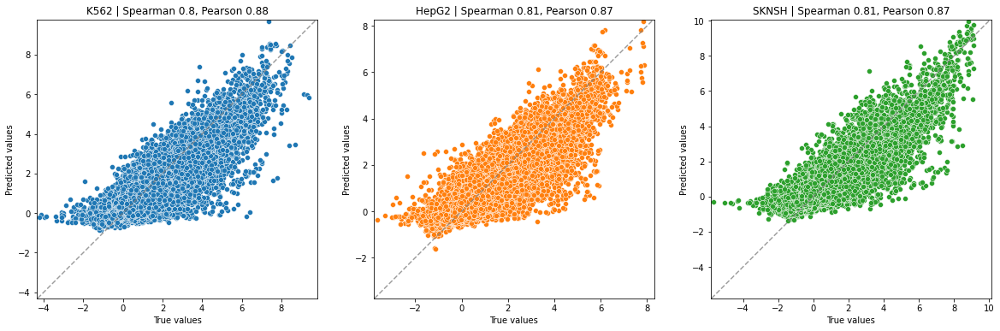


----------------------------------------------
Pearsons: [0.8793476949969903, 0.8732209948151414, 0.8668983389092575], average: 0.87
Spearmans: [0.7960350921538298, 0.8133392011086832, 0.8100845800210892], average: 0.81
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230112_002507 in eval mode


archive unpacked in ./


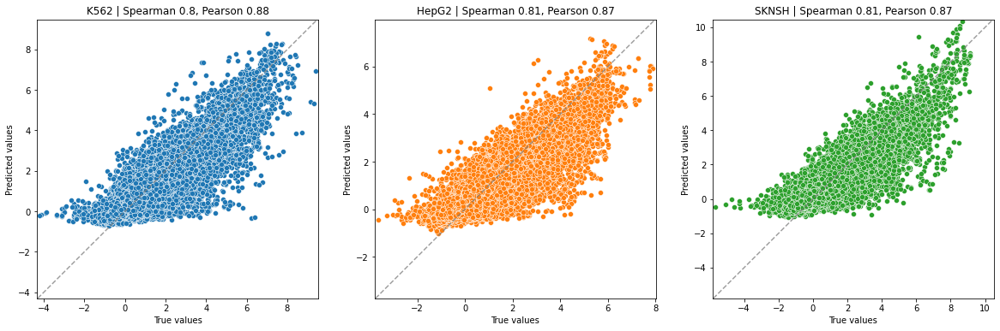


----------------------------------------------
Pearsons: [0.8780437100297545, 0.8721946989917666, 0.8669276520547514], average: 0.87
Spearmans: [0.7956448135337626, 0.8120038299313262, 0.8098347678445024], average: 0.81
----------------------------------------------
on chromosome 11
reporting per model results
Loaded model from 20230112_010807 in eval mode


archive unpacked in ./


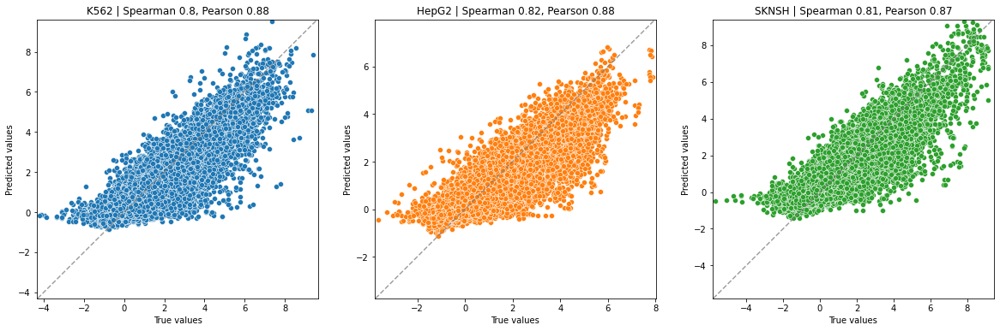


----------------------------------------------
Pearsons: [0.8820937429869122, 0.8759189255900935, 0.8678222778779678], average: 0.88
Spearmans: [0.7982436011823516, 0.8173590703289949, 0.8125620348874965], average: 0.81
----------------------------------------------
Aggregate results for chromosome 11


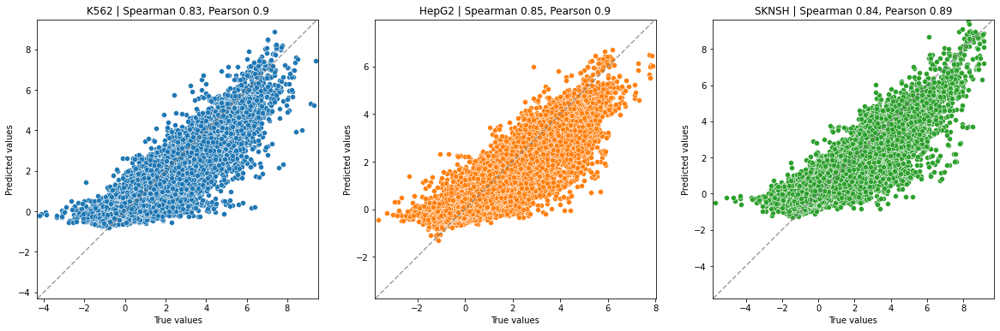

100%|██████████| 11/11 [1:02:27<00:00, 340.65s/it]


----------------------------------------------
Pearsons: [0.9021963388166727, 0.8979016473227257, 0.8888734427836384], average: 0.9
Spearmans: [0.825378333936981, 0.8455912615819091, 0.8375293081546897], average: 0.84
----------------------------------------------


In [31]:
ensemble_pearsons = []
all_pearsons = []

for i, (cv_model, cv_chrs) in enumerate( tqdm( list(zip(cv_list, test_list)) ) ):
    datamodule = boda.data.MPRA_DataModule(
        datafile_path=data_file,
        synth_seed=0,
        synth_val_pct=0.02,
        synth_test_pct=99.96,
        batch_size=2048,
        padded_seq_len=600, 
        num_workers=1,
        val_chrs=['X','Y'],
        test_chrs=cv_chrs,
        data_project=['BODA','UKBB','GTEX']
    )

    datamodule.setup()
    
    all_preds = []
    chr_pearsons = []

    for model_link in cv_model:
        print(f"on chromosome {i+1}")
        print("reporting per model results")
        if os.path.isdir('./artifacts'):
            shutil.rmtree('./artifacts')

        unpack_artifact(model_link)
        model_dir = './artifacts'
        my_model = model_fn(model_dir)

        my_model.cuda()
        my_model.eval()

        test_truths, test_preds = get_predictions(my_model, datamodule, dataset='chr_test')
        all_preds.append(test_preds)
        
        chr_pearsons.append( get_scatterplots(test_truths, test_preds) )

    print(f"Aggregate results for chromosome {i+1}")
    all_preds = np.stack(all_preds, axis=0).mean(axis=0)
    ensemble_pearsons.append( get_scatterplots(test_truths, all_preds) )
    all_pearsons.append( chr_pearsons )

In [36]:
ensemble_pearsons

[[0.8998117778763045, 0.8929802558920853, 0.8866134284107622],
 [0.8893002952194723, 0.8848653905855597, 0.8774330465707456],
 [0.8907777155307783, 0.8866247035884838, 0.8756223267511644],
 [0.9096348449112706, 0.9080672641140904, 0.8994555573137912],
 [0.8831019116768901, 0.8837931811239381, 0.8734087060176172],
 [0.9004129063433934, 0.8943970410573644, 0.8867146880975955],
 [0.8926690686337609, 0.8931000157168572, 0.8847509195870282],
 [0.8820262760271287, 0.8792655220040423, 0.8690912161753712],
 [0.9006075241928996, 0.8959132530751237, 0.8862563937111353],
 [0.8876329229212873, 0.8877558562090518, 0.8745618118137091],
 [0.9021963388166727, 0.8979016473227257, 0.8888734427836384]]

In [39]:
data = []
for i, chrom_level in enumerate(all_pearsons):
    for j, model_ver in enumerate(chrom_level):
        for k, cell_res in enumerate(model_ver):
            data.append(
                {
                    'pearson': cell_res,
                    'cell': ['K562', 'HepG2', 'SKNSH'][k],
                    'test_chrom': i+1,
                    'valid_chrom': j+2 if j >= i else j+1,
                    'aggregate': False
                }
            )
            
for i, chrom_level in enumerate(ensemble_pearsons):
    for k, cell_res in enumerate(chrom_level):
        data.append(
            {
                'pearson': cell_res,
                'cell': ['K562', 'HepG2', 'SKNSH'][k],
                'test_chrom': i+1,
                'valid_chrom': -1,
                'aggregate': True
            }
        )

            
data = pd.DataFrame.from_dict(data)

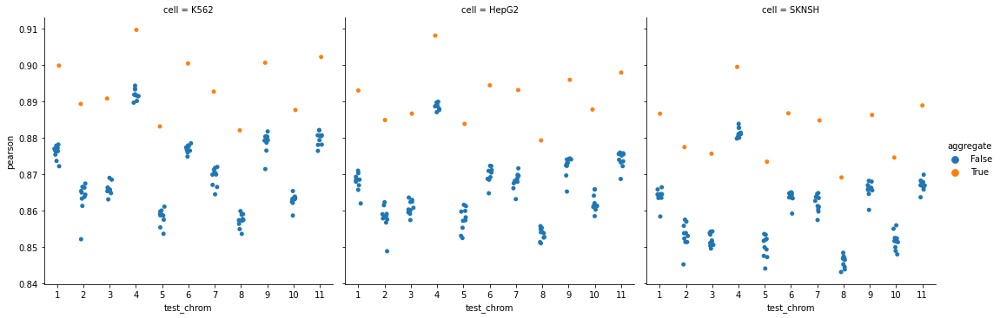

In [46]:
sns.catplot(
    data=data, kind="strip",
    x="test_chrom", y="pearson", hue="aggregate", col="cell",
)
plt.show()